# First big run (diffim sprint 2021)

The bps logs and quantum graphs are in `/project/mrawls/diffim_sprint_2021/bps/u/mrawls`

The processed data is in the `/datasets/hsc/gen3repo/rc2w50_ssw02` repo. There are two relevant collections:
* `u/mrawls/ApPipe_testrun1_bestSeeing` (small, only ~1500 quanta)
* `u/mrawls/ApPipe_bigrun_bestSeeing/20210219T233559Z` (large, about 83,000 quanta)

These correspond to APDBs in the postgres lsstdevapdb1, and the respective schemas are
* `mrawls_testrun1_bestSeeing`
* `mrawls_bigrun1_bestSeeing`

In [1]:
%matplotlib notebook

import os
import sys
import numpy as np
import matplotlib.pyplot as plt
import importlib
import pandas as pd
#import psycopg2

from astropy.coordinates import SkyCoord
import astropy.units as u

import lsst.geom
import lsst.daf.butler as dafButler
from lsst.ap.association import UnpackApdbFlags, MapDiaSourceConfig
from lsst.obs.decam import DarkEnergyCamera
from lsst.pipe.base import Struct

In [2]:
sys.path.append('/project/mrawls/ap_pipe-notebooks/')
import diaObjectAnalysis as doa
import apdbPlots as pla
import plotLightcurve as plc
import coaddAnalysis as coa

In [ ]:
# Only if you change anything in the code imported above
importlib.reload(doa)
importlib.reload(pla)
importlib.reload(plc)
importlib.reload(coa)

In [3]:
repo = '/datasets/hsc/gen3repo/rc2w50_ssw02'

In [4]:
butler = dafButler.Butler(repo)

## Look at the mini test run first
Be sure to specify `gen` and `instrument` in your calls to `loadTable`, `addVisitCcdToSrcTable`, and `makeSrcTableFlags`!

In [5]:
objTable, srcTable, goodObj, goodSrc = pla.loadTables(repo,
                                                      dbType='postgres',
                                                      dbName='lsstdevapdb1',
                                                      schema='mrawls_testrun1_bestSeeing',
                                                      gen='gen3',
                                                      instrument='HSC')

In [6]:
srcTable = pla.addVisitCcdToSrcTable(srcTable, instrument='HSC', gen='gen3', butler=butler)

In [7]:
flagTable, srcTableFlags, flagFilter, goodSrc, goodObj = pla.makeSrcTableFlags(srcTable, objTable,
                                                                               gen='gen3', instrument='HSC',
                                                                               repo=repo)

<IPython.core.display.Javascript object>


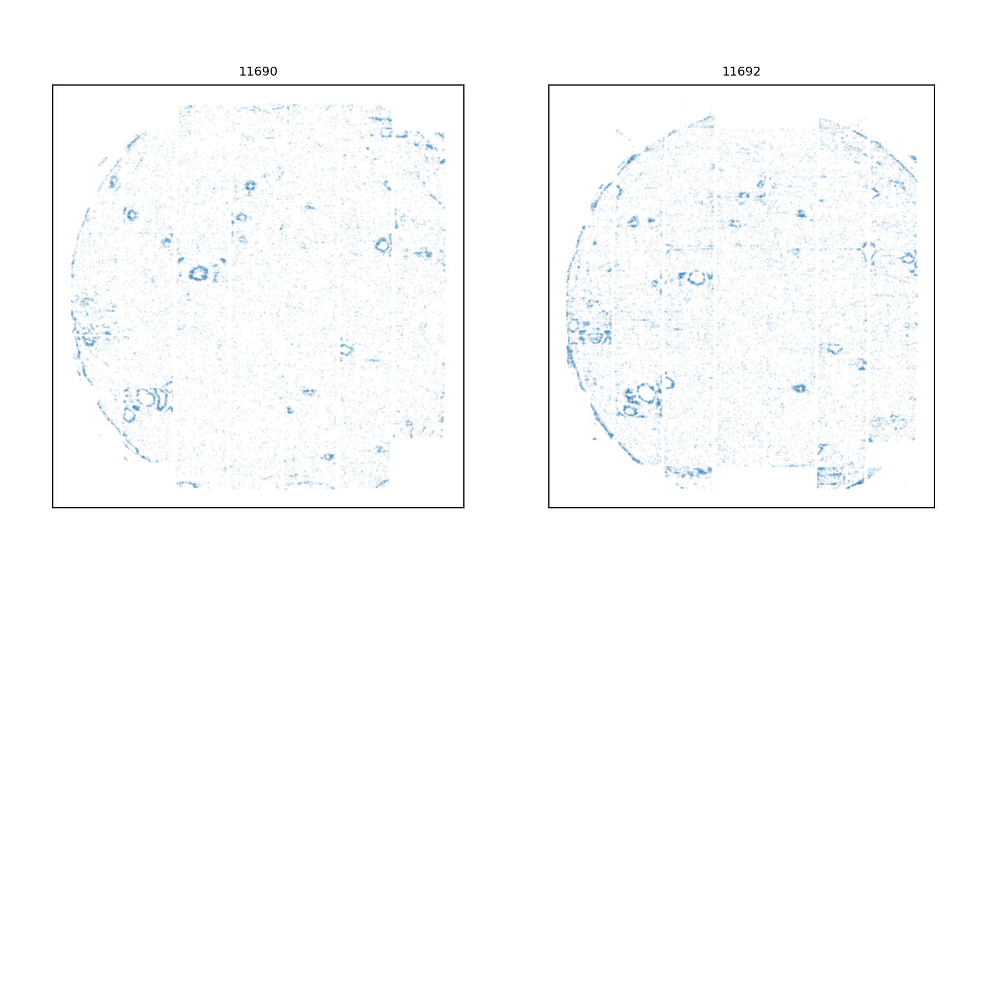

In [8]:
pla.plotDiaSourcesOnSkyGrid(repo, goodSrc)

<IPython.core.display.Javascript object>


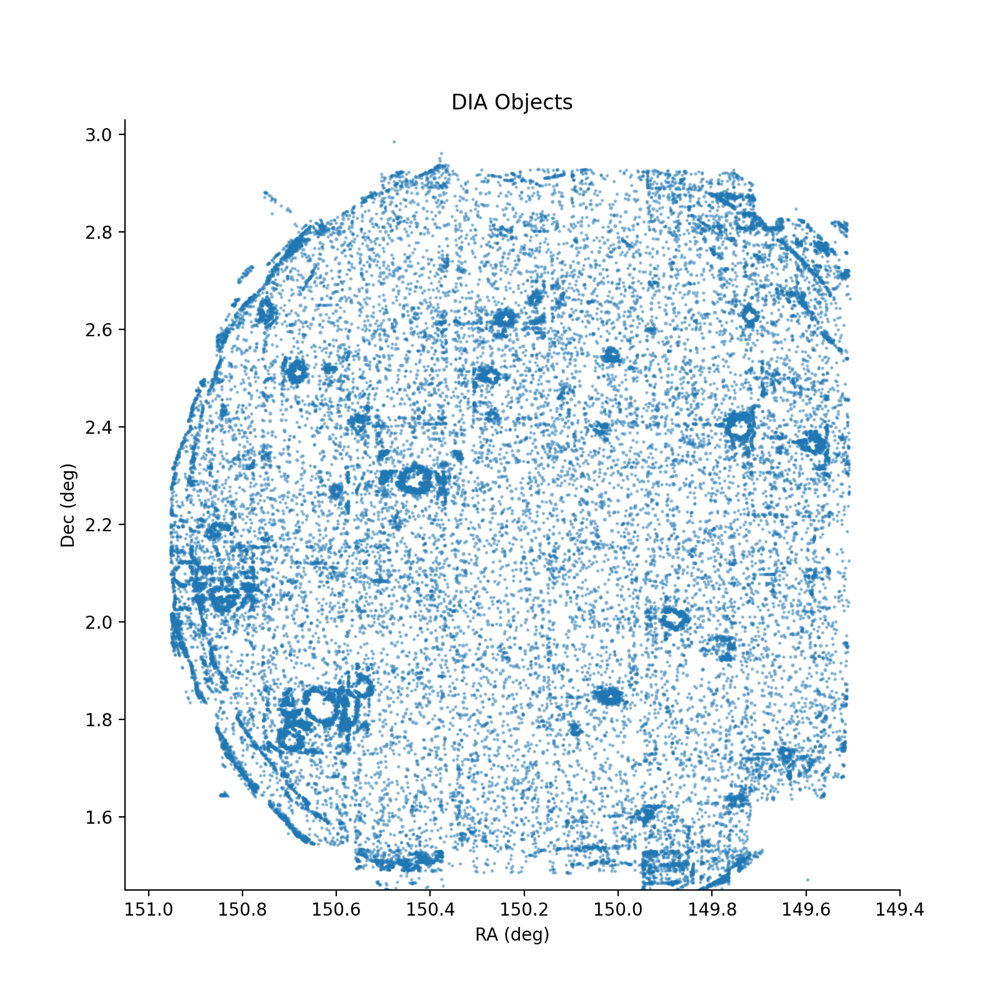

Text(0.5, 1.0, 'DIA Objects')

In [9]:
fig = plt.figure(figsize=(8,8))

xlim = (151.05, 149.40)
ylim = (1.45, 3.03)
#cutoff = 10  # only plot DIA Objects composed of cutoff or more DIA Sources
cutoff = 0

ax = fig.add_subplot(111)
plt.setp(ax, xlim=xlim, ylim=ylim)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.scatter(goodObj.loc[goodObj['nDiaSources'] > cutoff, 'ra'], goodObj.loc[goodObj['nDiaSources'] > cutoff, 'decl'], 
           c='C0', s=goodObj.loc[goodObj['nDiaSources'] > cutoff, 'nDiaSources'], marker='o', alpha=0.4)
ax.set_xlabel('RA (deg)')
ax.set_ylabel('Dec (deg)')
ax.set_title('DIA Objects')

## Do it again but for the first big run

In [10]:
collections = 'u/mrawls/ApPipe_bigrun_bestSeeing'

In [11]:
objTable, srcTable, goodObj, goodSrc = pla.loadTables(repo,
                                                      dbType='postgres',
                                                      dbName='lsstdevapdb1',
                                                      schema='mrawls_bigrun1_bestSeeing',
                                                      gen='gen3',
                                                      instrument='HSC')

In [12]:
srcTable = pla.addVisitCcdToSrcTable(srcTable, instrument='HSC', gen='gen3', butler=butler)
flagTable, srcTableFlags, flagFilter, goodSrc, goodObj = pla.makeSrcTableFlags(srcTable, objTable,
                                                                               gen='gen3', instrument='HSC',
                                                                               repo=repo)

<IPython.core.display.Javascript object>


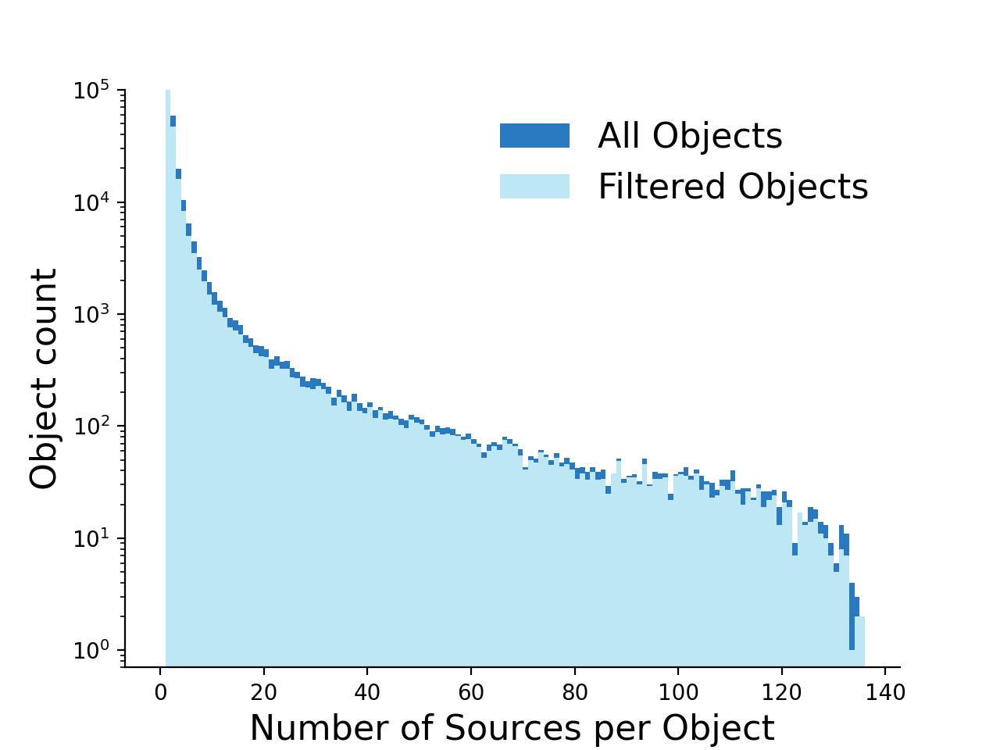

In [13]:
hist = doa.plotDiaObjectHistogram(objTable, goodObj)

In [14]:
print(len(objTable), len(goodObj))

744627 537816


In [15]:
print(len(srcTable), len(goodSrc))

5522172 3461752


<IPython.core.display.Javascript object>


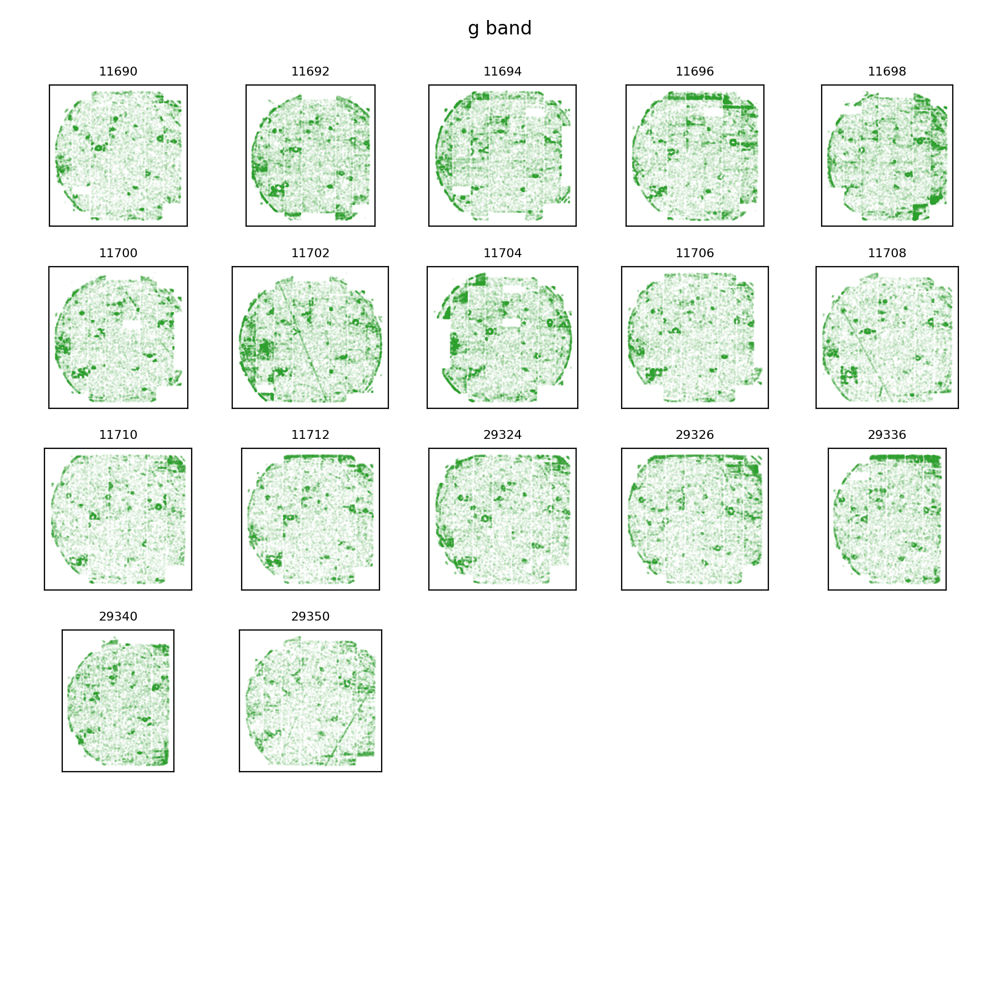

<IPython.core.display.Javascript object>


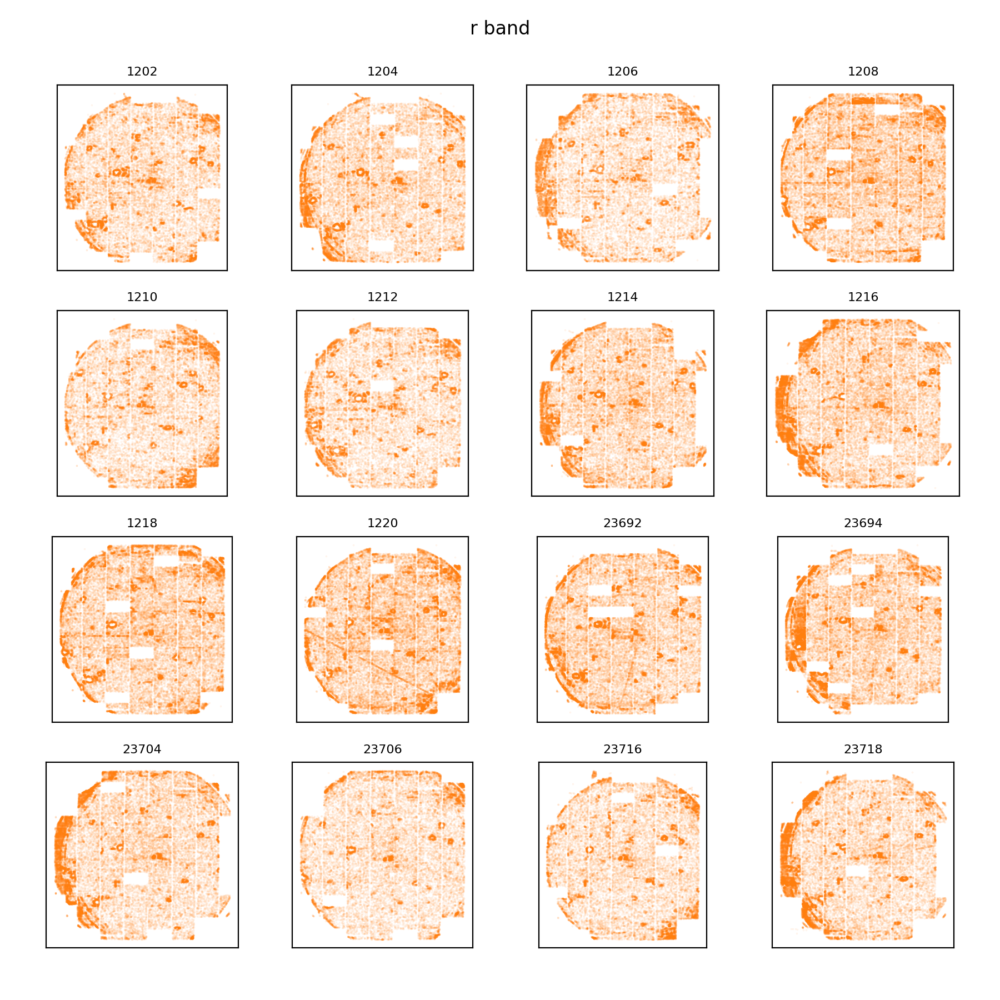

<IPython.core.display.Javascript object>


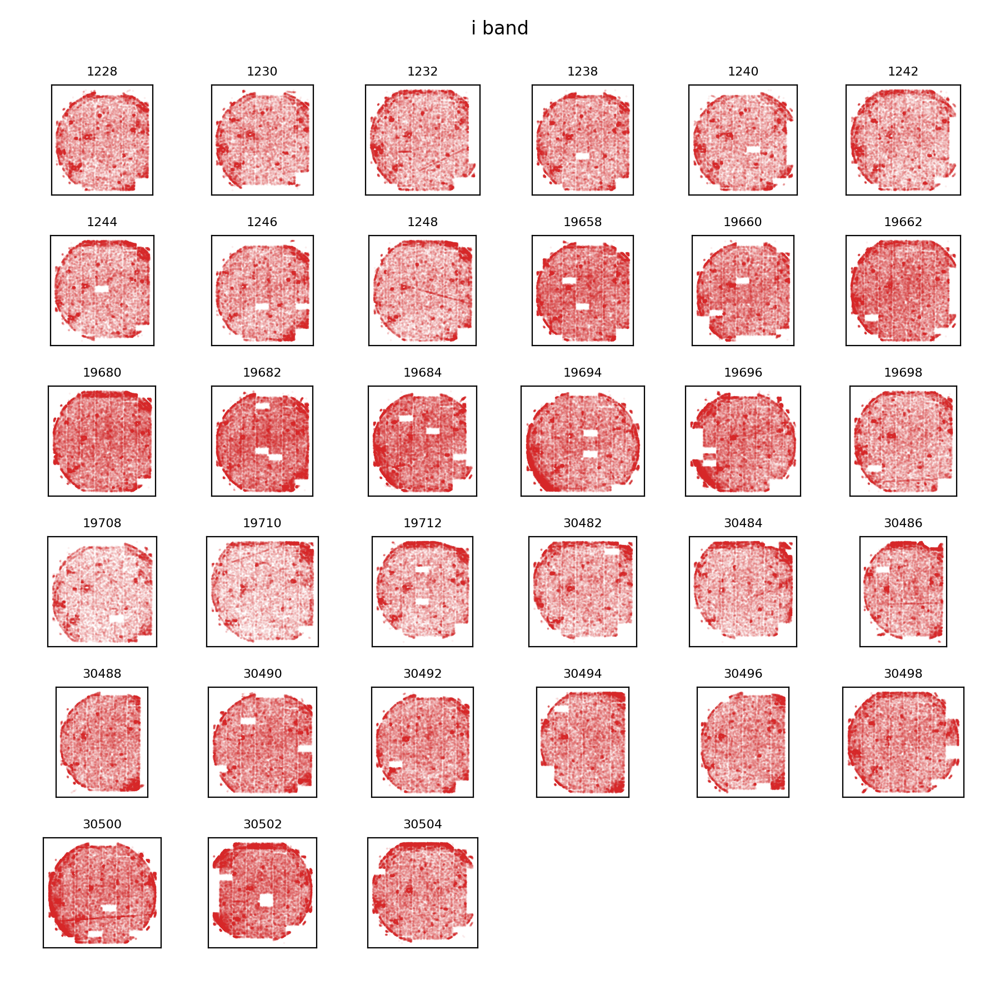

<IPython.core.display.Javascript object>


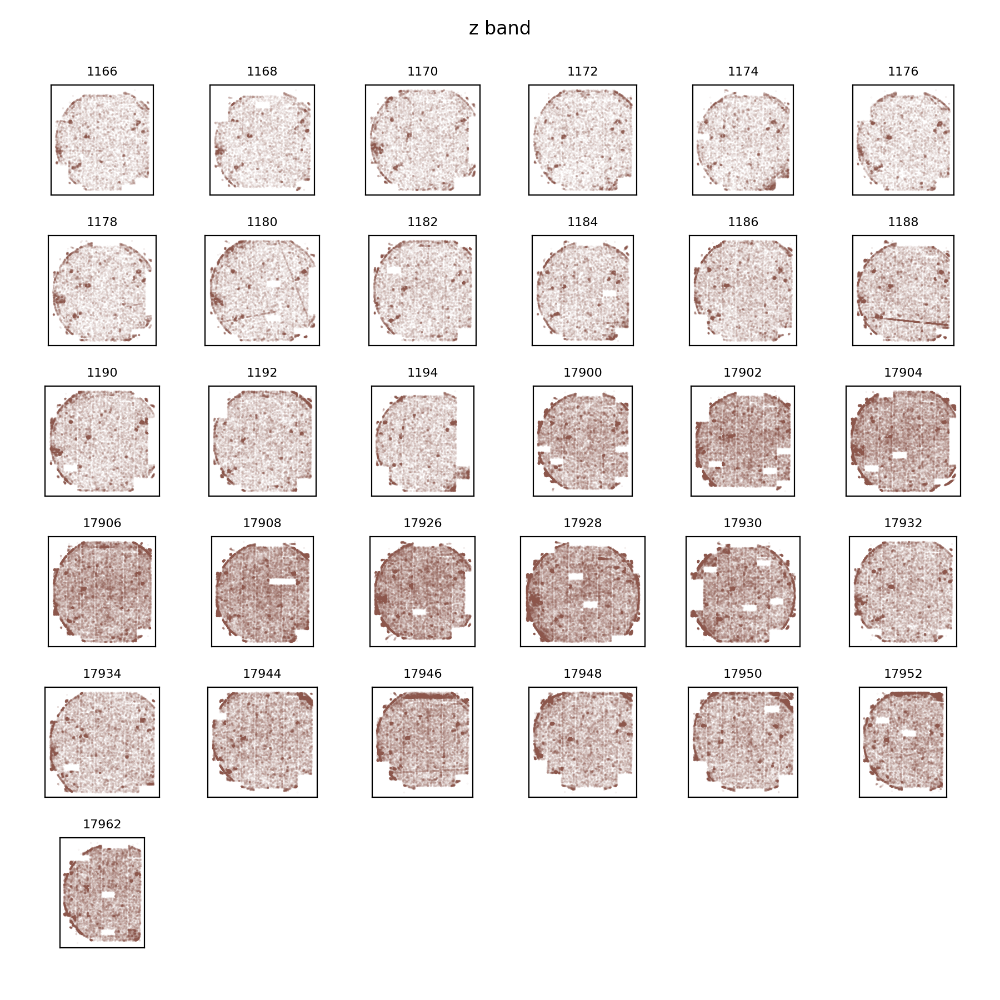

<IPython.core.display.Javascript object>


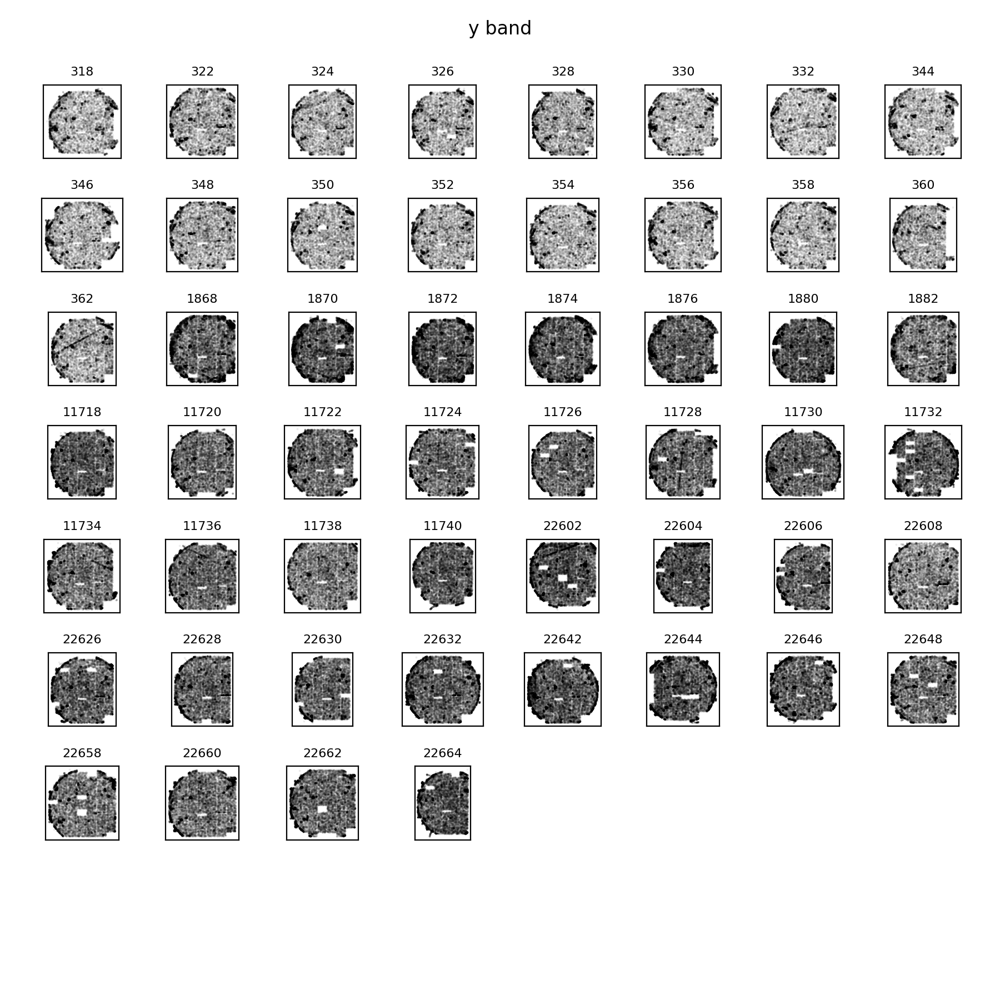

In [16]:
bandList = ['g', 'r', 'i', 'z', 'y']
colorList = ['C2', 'C1', 'C3', 'C5', 'k']

for band, color in zip(bandList, colorList):
    pla.plotDiaSourcesOnSkyGrid(repo, goodSrc.loc[goodSrc['filterName'] == band], title=band+' band', color=color)

<IPython.core.display.Javascript object>


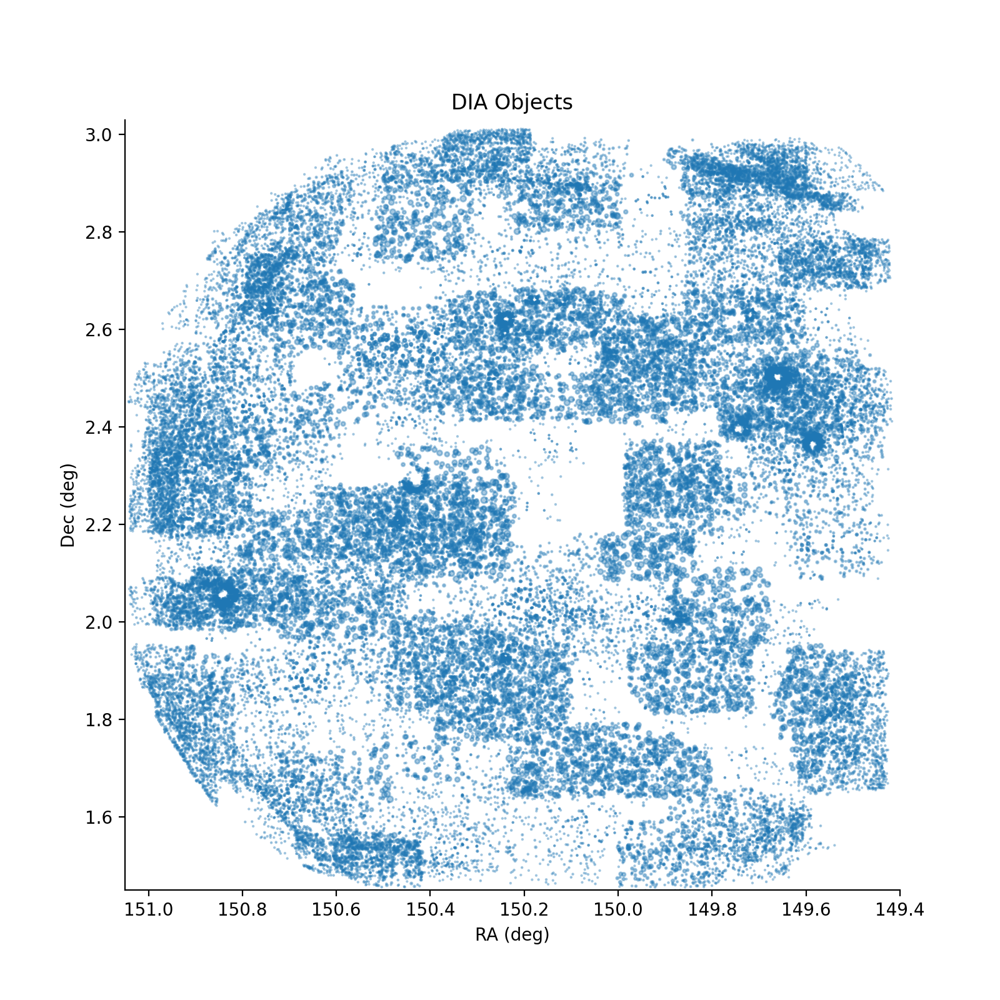

Text(0.5, 1.0, 'DIA Objects')

In [17]:
fig = plt.figure(figsize=(8,8))

#xlim = (272, 270.5)
#ylim = (-31.2, -30.0)

xlim = (151.05, 149.40)
ylim = (1.45, 3.03)
cutoff = 2  # only plot DIA Objects composed of cutoff or more DIA Sources

ax = fig.add_subplot(111)
plt.setp(ax, xlim=xlim, ylim=ylim)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.scatter(goodObj.loc[goodObj['nDiaSources'] > cutoff, 'ra'], goodObj.loc[goodObj['nDiaSources'] > cutoff, 'decl'], 
           c='C0', s=goodObj.loc[goodObj['nDiaSources'] > cutoff, 'nDiaSources']/10, marker='o', alpha=0.4)
ax.set_xlabel('RA (deg)')
ax.set_ylabel('Dec (deg)')
ax.set_title('DIA Objects')

<IPython.core.display.Javascript object>


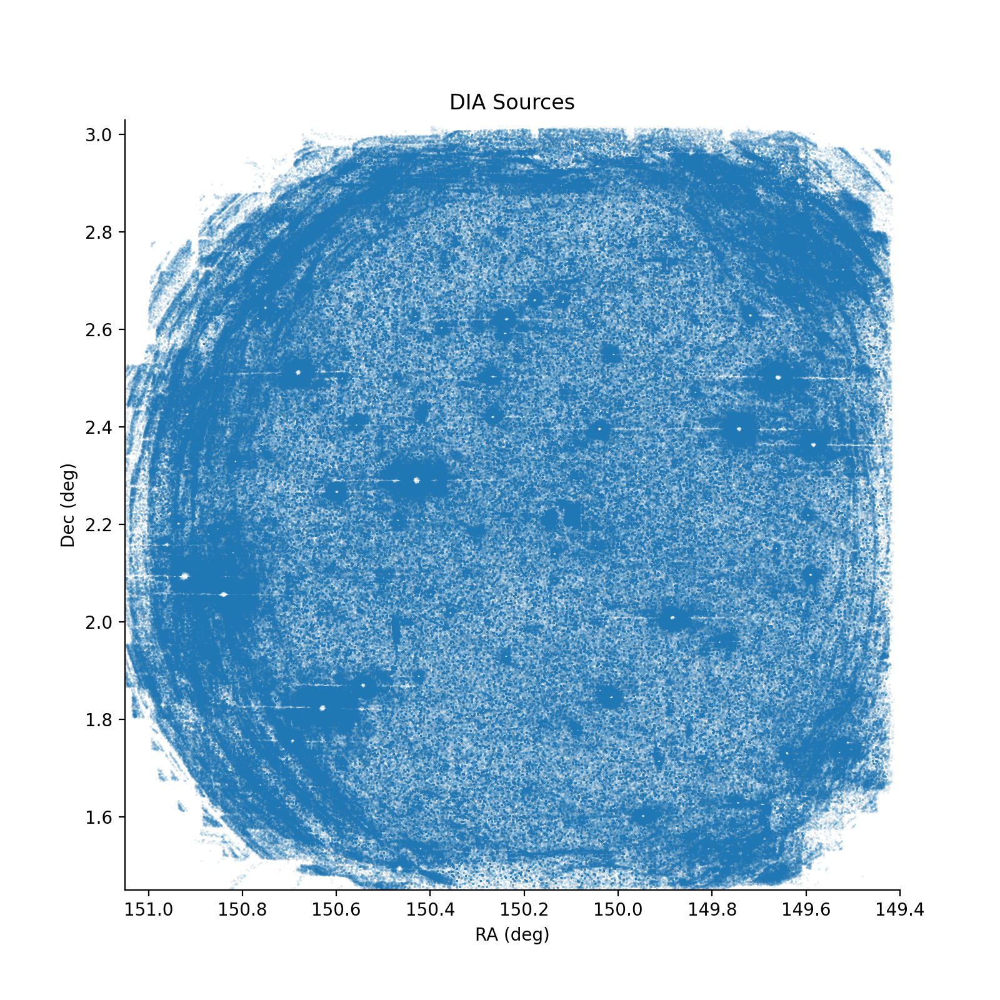

Text(0.5, 1.0, 'DIA Sources')

In [18]:
fig = plt.figure(figsize=(8,8))

#xlim = (272, 270.5)
#ylim = (-31.2, -30.0)

xlim = (151.05, 149.40)
ylim = (1.45, 3.03)
#cutoff = 2  # only plot DIA Objects composed of cutoff or more DIA Sources

ax = fig.add_subplot(111)
plt.setp(ax, xlim=xlim, ylim=ylim)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.scatter(goodSrc['ra'], goodSrc['decl'], c='C0', s=0.01, marker='o', alpha=0.4)
ax.set_xlabel('RA (deg)')
ax.set_ylabel('Dec (deg)')
ax.set_title('DIA Sources')

<IPython.core.display.Javascript object>


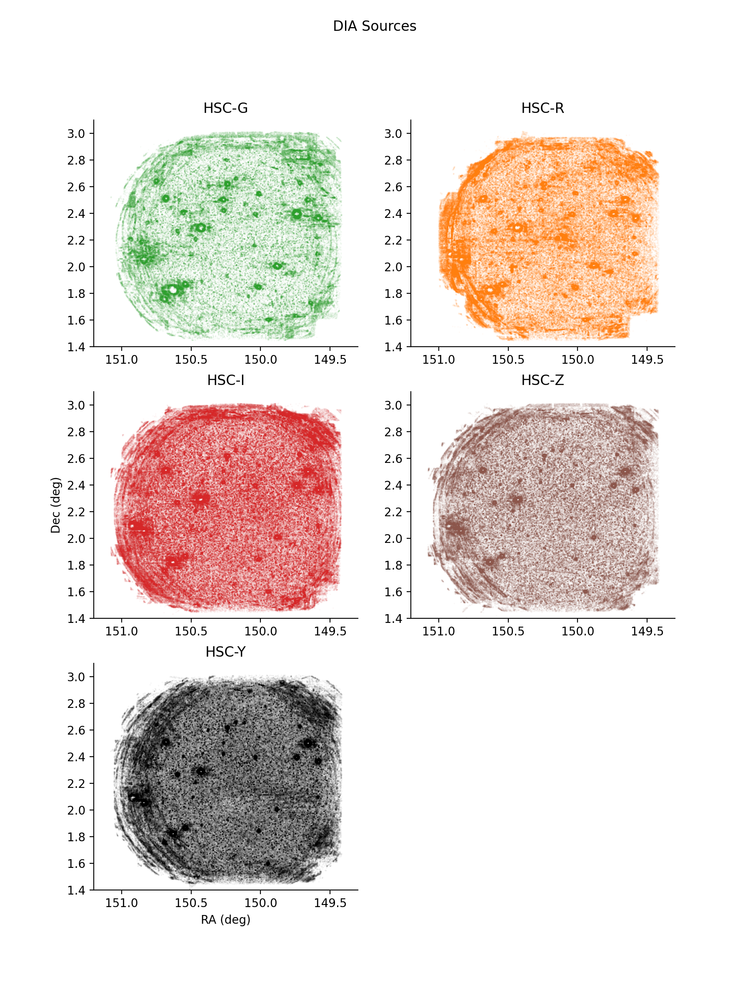

In [19]:
fig, axs = plt.subplots(3, 2, figsize=(9, 12))

axG = axs[0, 0]
axR = axs[0, 1]
axI = axs[1, 0]
axZ = axs[1, 1]
axY = axs[2, 0]
#axHits = axs[2, 1]

ax0 = axs[2, 1]
ax0.axis('off')

axList = [axG, axR, axI, axZ, axY]
colorList = ['C2', 'C1', 'C3', 'C5', 'k']

xlim = (151.2, 149.3)
ylim = (1.4, 3.1)
plt.setp(axs, xlim=xlim, ylim=ylim)


### DIA OBJECTS ###

#fig.suptitle('DIA Objects with at least 2 DIA Sources')
#nSrc = 2  # threshold for which DIA Objects to plot (only those with > nSrc constituent DIA Sources)
#pSize = 2

#goodGFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['gPSFluxMean'] > 0)
#goodRFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['rPSFluxMean'] > 0)
#goodIFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['iPSFluxMean'] > 0)
#goodZFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['zPSFluxMean'] > 0)
#goodYFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['yPSFluxMean'] > 0)

#filterList = [goodGFilter, goodRFilter, goodIFilter, goodZFilter, goodYFilter]

#for ax, filtered, color in zip(axList, filterList, colorList):
#    ax.scatter(goodObj.loc[filtered, 'ra'], goodObj.loc[filtered, 'decl'], c=color, s=pSize, marker='.', alpha=0.4)


### DIA SOURCES ###

fig.suptitle('DIA Sources')
pSize = 0.001

goodGFilter = (goodSrc['filterName'] == 'g')
goodRFilter = (goodSrc['filterName'] == 'r')
goodIFilter = (goodSrc['filterName'] == 'i')
goodZFilter = (goodSrc['filterName'] == 'z')
goodYFilter = (goodSrc['filterName'] == 'y')

filterList = [goodGFilter, goodRFilter, goodIFilter, goodZFilter, goodYFilter]

for ax, filtered, color in zip(axList, filterList, colorList):
    ax.scatter(goodSrc.loc[filtered, 'ra'], goodSrc.loc[filtered, 'decl'], c=color, s=pSize, marker='o', alpha=0.4)

axY.set_xlabel('RA (deg)')
#axHits.set_xlabel('RA (deg)')
axI.set_ylabel('Dec (deg)')

axG.set_title('HSC-G')
axR.set_title('HSC-R')
axI.set_title('HSC-I')
axZ.set_title('HSC-Z')
axY.set_title('HSC-Y')
#axHits.set_title('DECam g (HiTS)')

for ax in axList:
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

<IPython.core.display.Javascript object>


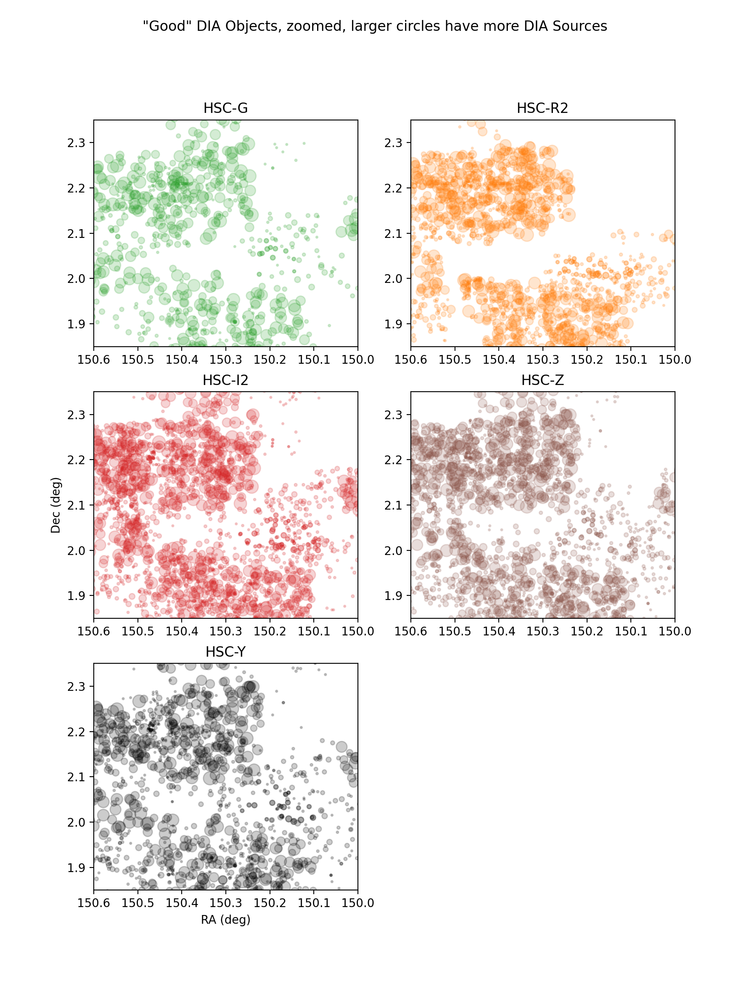

In [20]:
fig, axs = plt.subplots(3, 2, figsize=(9, 12))

fig.suptitle('"Good" DIA Objects, zoomed, larger circles have more DIA Sources')

nSrc = 2  # threshold for which DIA Objects to plot (only those with > nSrc constituent DIA Sources)

axG = axs[0, 0]
axR = axs[0, 1]
axI = axs[1, 0]
axZ = axs[1, 1]
axY = axs[2, 0]

ax0 = axs[2, 1]
ax0.axis('off')

axList = [axG, axR, axI, axZ, axY]

xlim = [150.6, 150.0]
ylim = [1.85, 2.35]
plt.setp(axs, xlim=xlim, ylim=ylim)

goodGFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['gPSFluxMean'] > 0)
goodRFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['rPSFluxMean'] > 0)
goodIFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['iPSFluxMean'] > 0)
goodZFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['zPSFluxMean'] > 0)
goodYFilter = (goodObj['nDiaSources'] > nSrc) & (goodObj['yPSFluxMean'] > 0)

goodFilterList = [goodGFilter, goodRFilter, goodIFilter, goodZFilter, goodYFilter]

axY.set_xlabel('RA (deg)')
axI.set_ylabel('Dec (deg)')

axG.set_title('HSC-G')
axR.set_title('HSC-R2')
axI.set_title('HSC-I2')
axZ.set_title('HSC-Z')
axY.set_title('HSC-Y')

colorList = ['C2', 'C1', 'C3', 'C5', 'k']

for ax, goodFilter, color in zip(axList, goodFilterList, colorList):
    ax.scatter(goodObj.loc[goodFilter, 'ra'],
               goodObj.loc[goodFilter, 'decl'],
               s=goodObj.loc[goodFilter, 'nDiaSources'], c=color, marker='o', alpha=0.2)

<IPython.core.display.Javascript object>


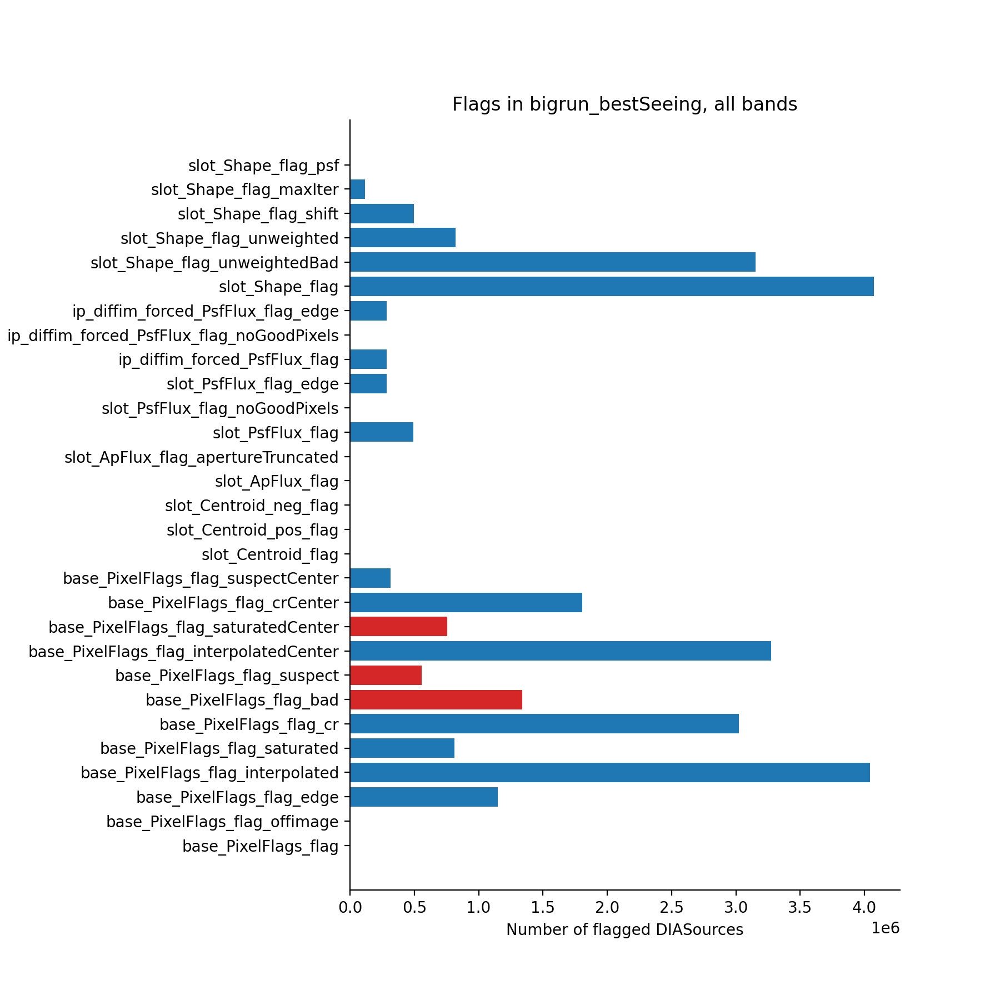

In [21]:
pla.plotFlagHist(srcTable, title='Flags in bigrun_bestSeeing, all bands')

<IPython.core.display.Javascript object>


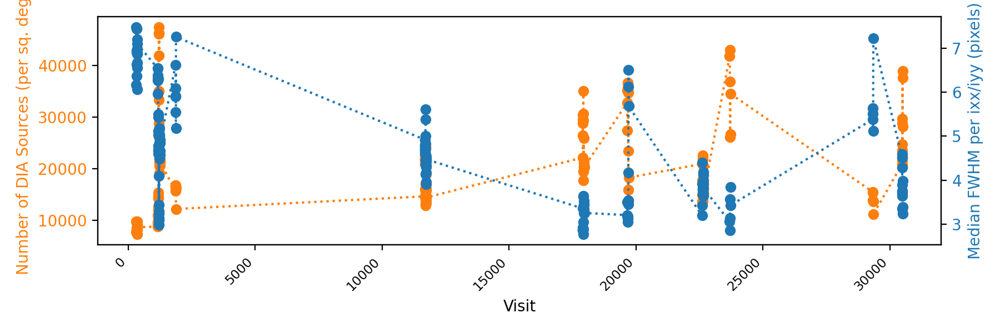

In [22]:
pla.plotDiaSourcesPerVisit(repo, srcTable, gen='gen3', instrument='HSC', collections=collections)

<IPython.core.display.Javascript object>


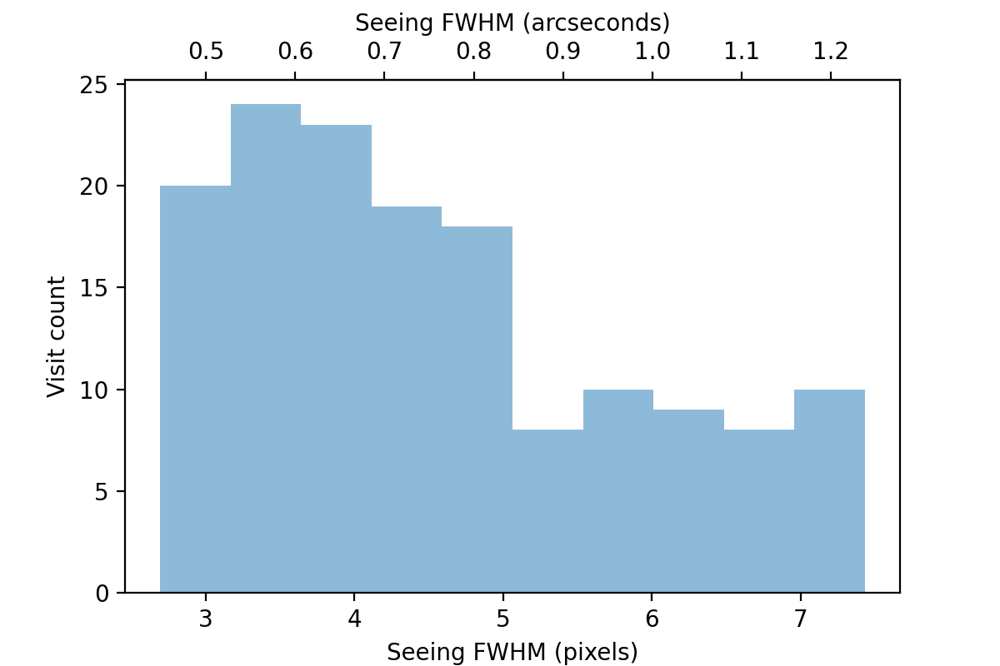

In [23]:
pla.plotSeeingHistogram(repo, goodSrc, gen='gen3', instrument='HSC', collections=collections)

<IPython.core.display.Javascript object>


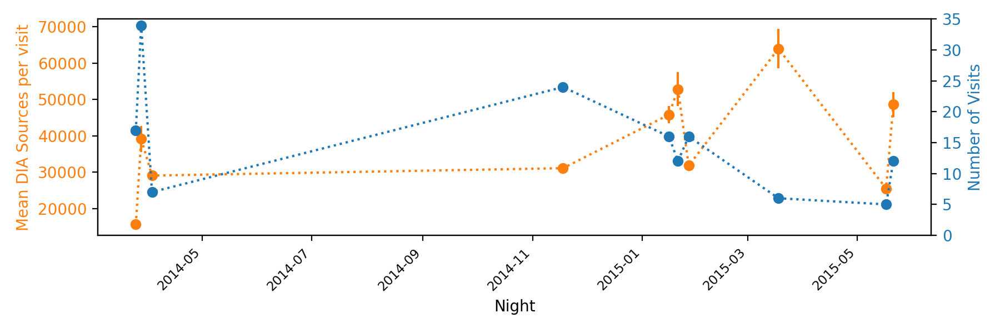

In [24]:
pla.plotDiaSourcesPerNight(srcTable)

In [25]:
# Jim's sorcery, which is now in pla.addVisitCcdToSrcTable for HSC only
def getVisitAndDetector(butler, instrumentName, integerVisitDetectorId):
    instrumentDataId = butler.registry.expandDataId(instrument=instrumentName)
    packer = butler.registry.dimensions.makePacker("visit_detector", instrumentDataId)
    dataId = packer.unpack(integerVisitDetectorId)
    assert packer.pack(dataId) == integerVisitDetectorId
    visit = dataId['visit']
    detector = dataId['detector']
    return visit, detector

In [26]:
getVisitAndDetector(butler, 'HSC', 2344907)

(11724, 107)

## Let's try to look at a template

In [ ]:
# Used this to turn a timestamped repo into a chained repo... now I know how to do this in bps!
# it worked!
#butler = dafButler.Butler(repo, writeable=True)
#registry = butler.registry
#collection = 'u/mrawls/ApPipe_bigrun_bestSeeing'
#if collection in list(registry.queryCollections()):
#    registry.removeCollection(collection)
#registry.registerCollection(collection, type=dafButler.CollectionType.CHAINED)
#registry.setCollectionChain(collection, ['HSC/raw/all', 'HSC/calib',
#                                         'u/diffim_sprint/templates_bestThirdSeeing',
#                                         'u/mrawls/ApPipe_bigrun_bestSeeing/20210219T233559Z',
#                                         'skymaps', 'refcats'])

In [27]:
skymap = butler.get('skyMap', skymap='hsc_rings_v1', instrument='HSC', collections='skymaps')
tract = skymap.generateTract(9813)

In [28]:
tract.getPatchInfo((6,4))

PatchInfo(index=(6, 4), innerBBox=(minimum=(24000, 16000), maximum=(27999, 19999)), outerBBox=(minimum=(23900, 15900), maximum=(28099, 20099)))

In [29]:
everyPatchList = [patch.getIndex() for patch in tract]

In [30]:
everySequentialPatchList = [tract.getSequentialPatchIndex(tract[idx]) for idx in range(len(tract))]

In [31]:
print(len(everyPatchList), len(everySequentialPatchList))

81 81


In [33]:
indexmap = {}
for patch in tract:
    indexmap[str(tract.getSequentialPatchIndex(patch))] = patch.getIndex()

In [34]:
testDataId = {'instrument': 'HSC', 'patch': 7, 'band': 'g', 'tract': 9813, 'skymap': 'hsc_rings_v1'}
coadd_test = butler.get('deepCoadd', collections=collections, dataId=testDataId)

In [35]:
dataPatchList, _, _ = coa.getPatchConstituents(repo, tractIndex=9813, band='r', gen='gen3',
                                               instrument='HSC', collections=collections, skymapName='hsc_rings_v1')

<IPython.core.display.Javascript object>


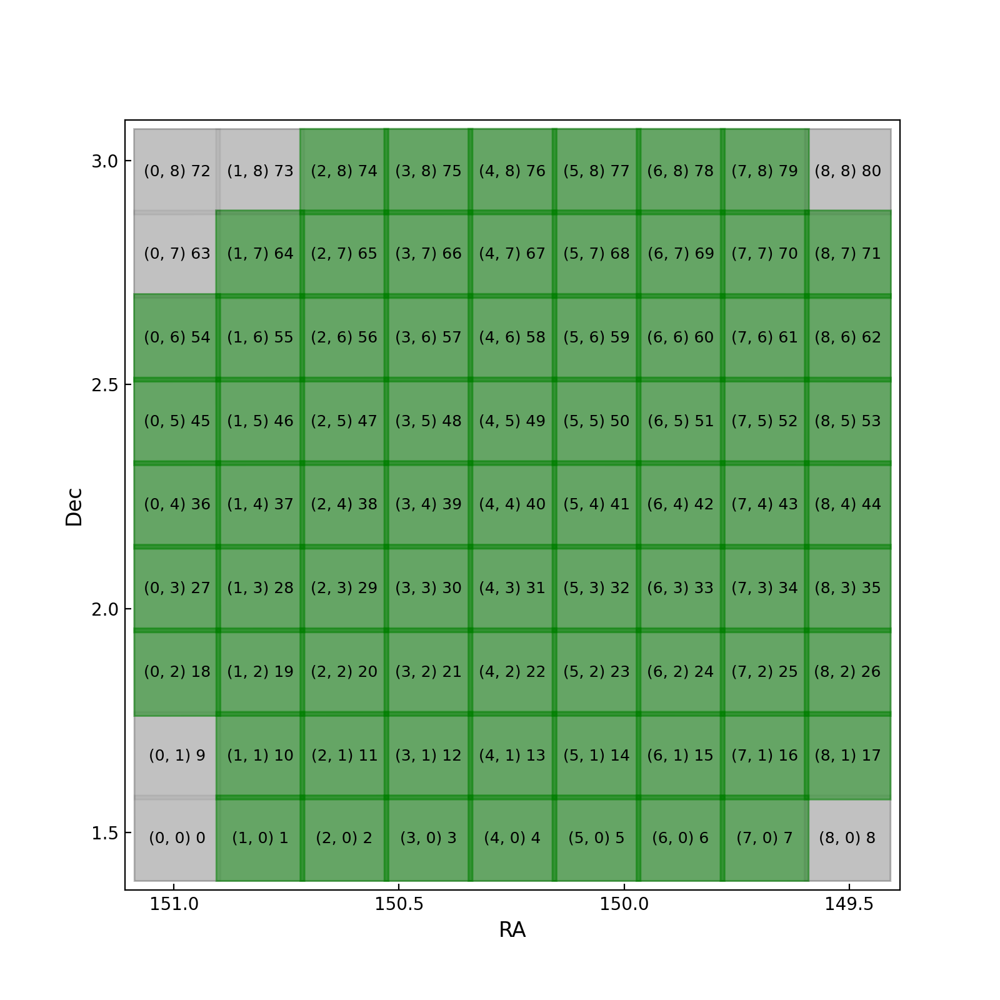

In [36]:
coa.plotTractOutline(tract, dataPatchList, gen='gen3')

In [37]:
patchesToLoad = [patch for patch in tract if tract.getSequentialPatchIndex(patch) in dataPatchList]
patchesToLoad[0:2]

[PatchInfo(index=(1, 0), innerBBox=(minimum=(4000, 0), maximum=(7999, 3999)), outerBBox=(minimum=(3900, 0), maximum=(8099, 4099))),
 PatchInfo(index=(2, 0), innerBBox=(minimum=(8000, 0), maximum=(11999, 3999)), outerBBox=(minimum=(7900, 0), maximum=(12099, 4099)))]

In [38]:
patchIndicesToLoad = [patch.getIndex() for patch in patchesToLoad]
patchIndicesToLoad[0:2]

[(1, 0), (2, 0)]

<IPython.core.display.Javascript object>


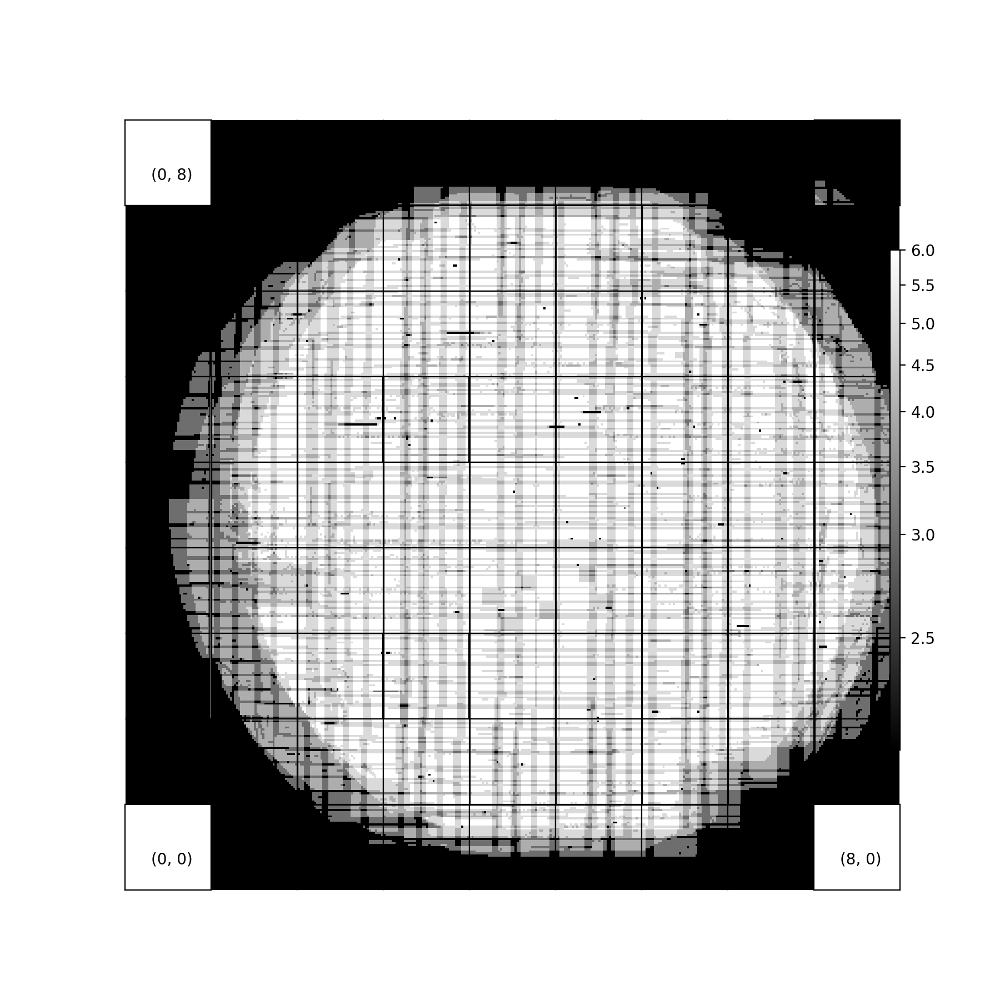

<IPython.core.display.Javascript object>


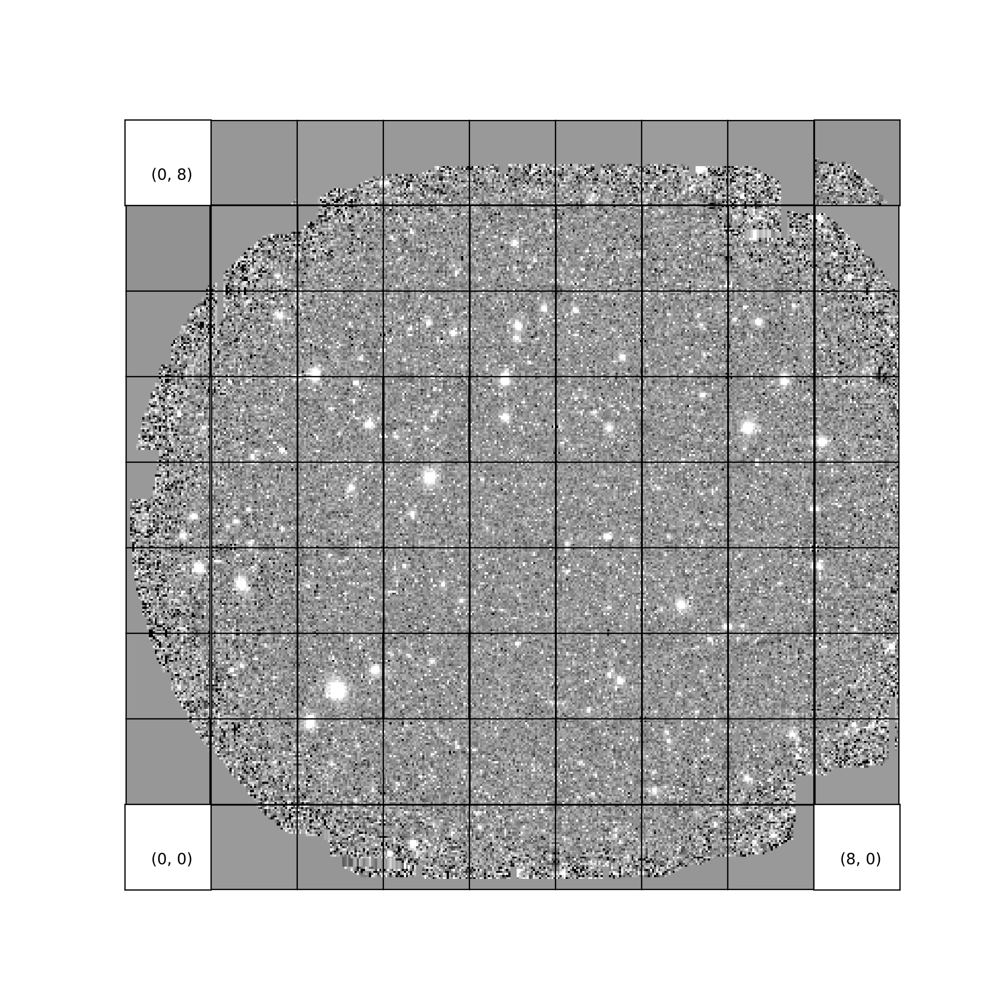

<IPython.core.display.Javascript object>


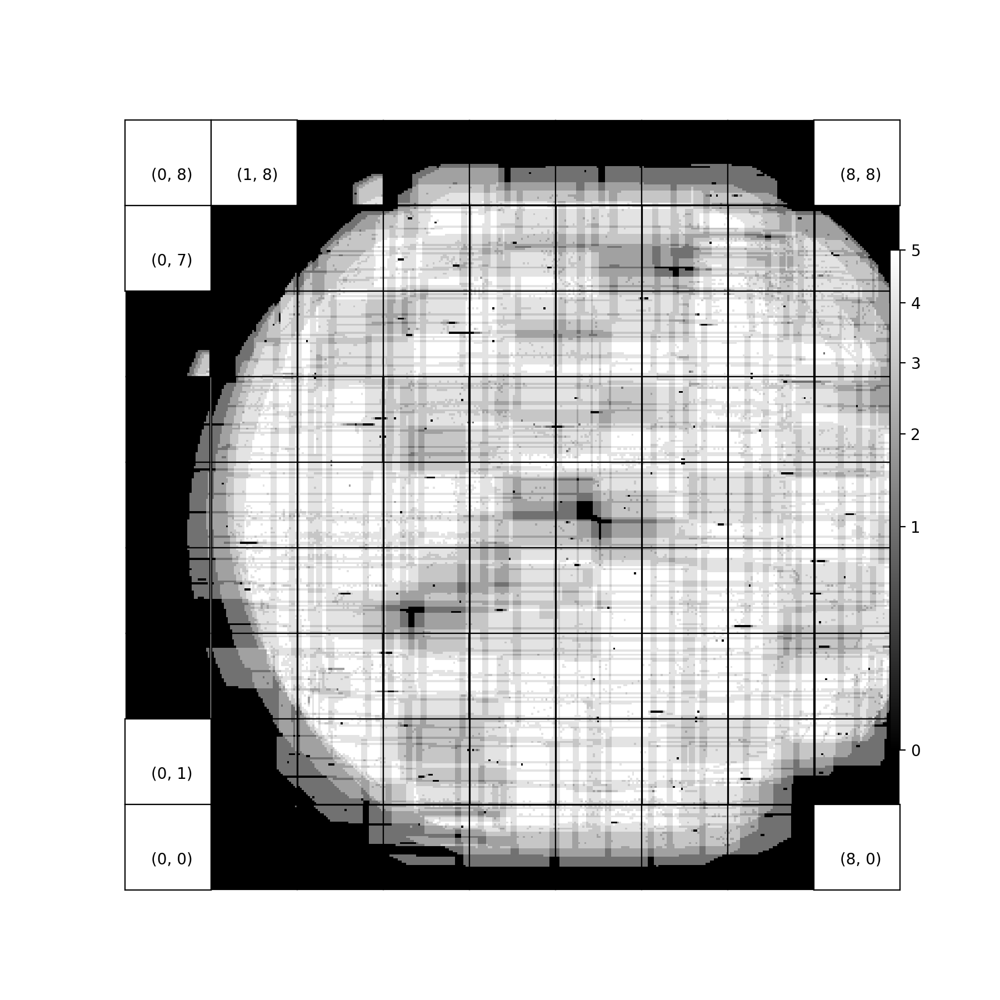

/project/mrawls/ap_pipe-notebooks/coaddAnalysis.py:339: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  patch_y.append(int(patch[m+1:]))


<IPython.core.display.Javascript object>


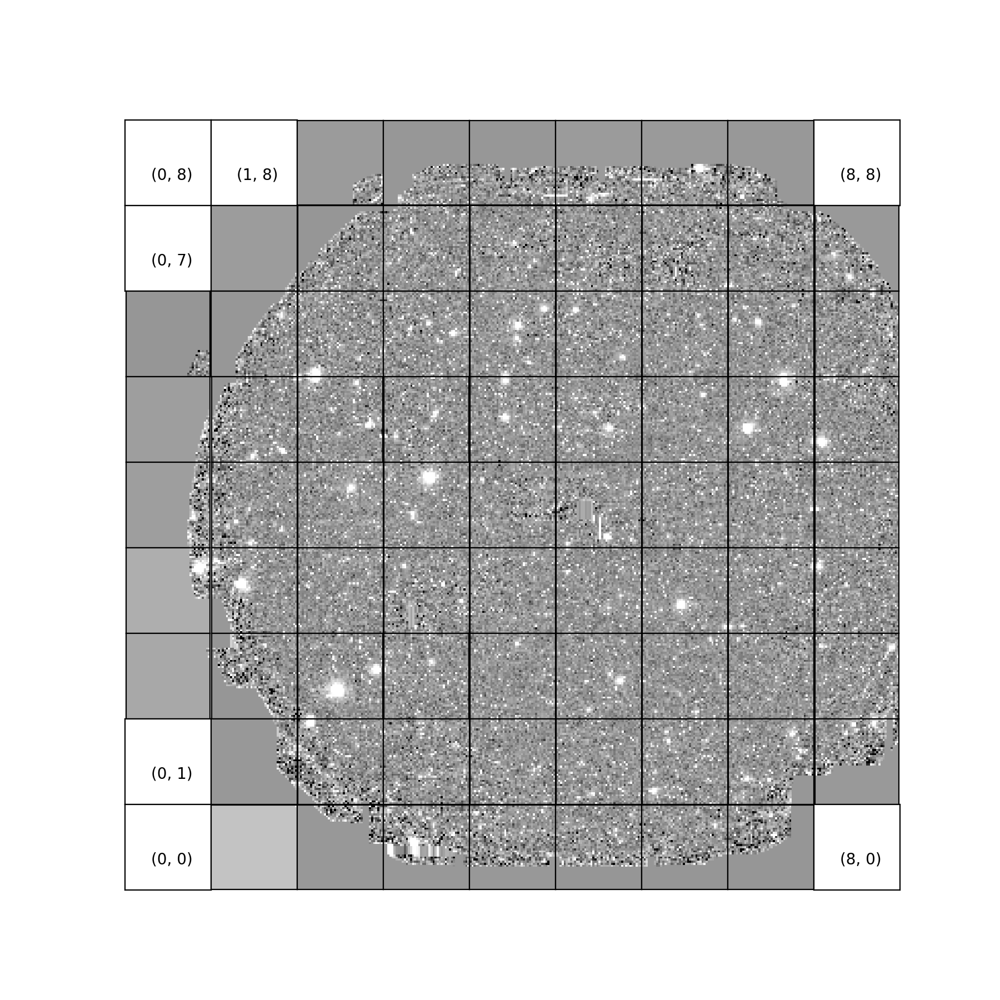

<IPython.core.display.Javascript object>


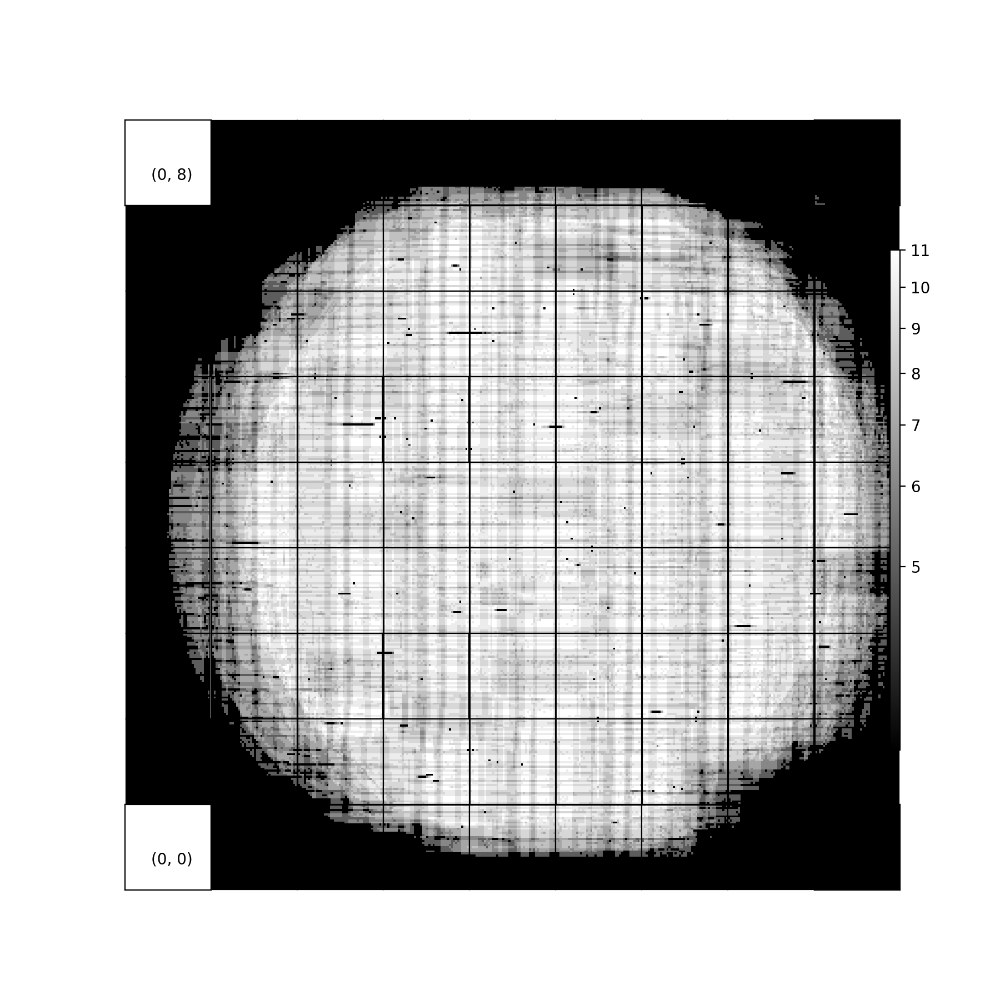

<IPython.core.display.Javascript object>


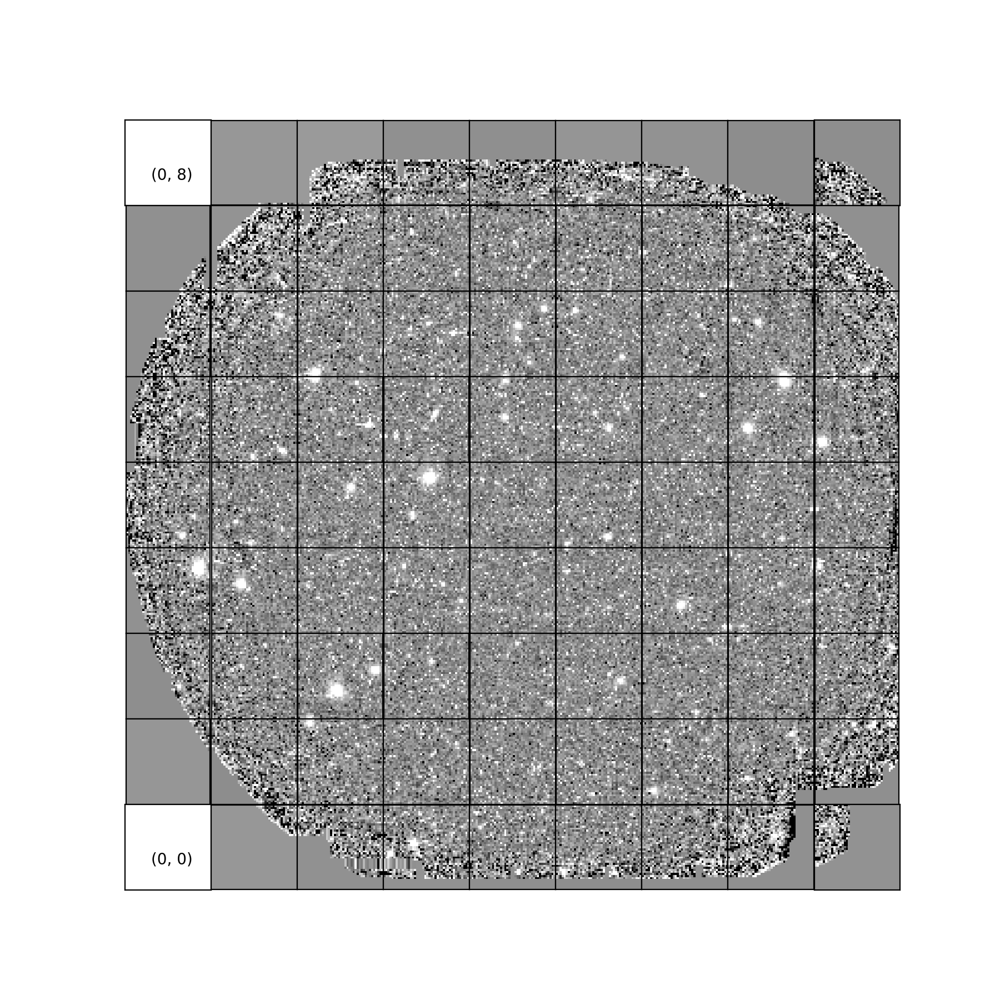

<IPython.core.display.Javascript object>


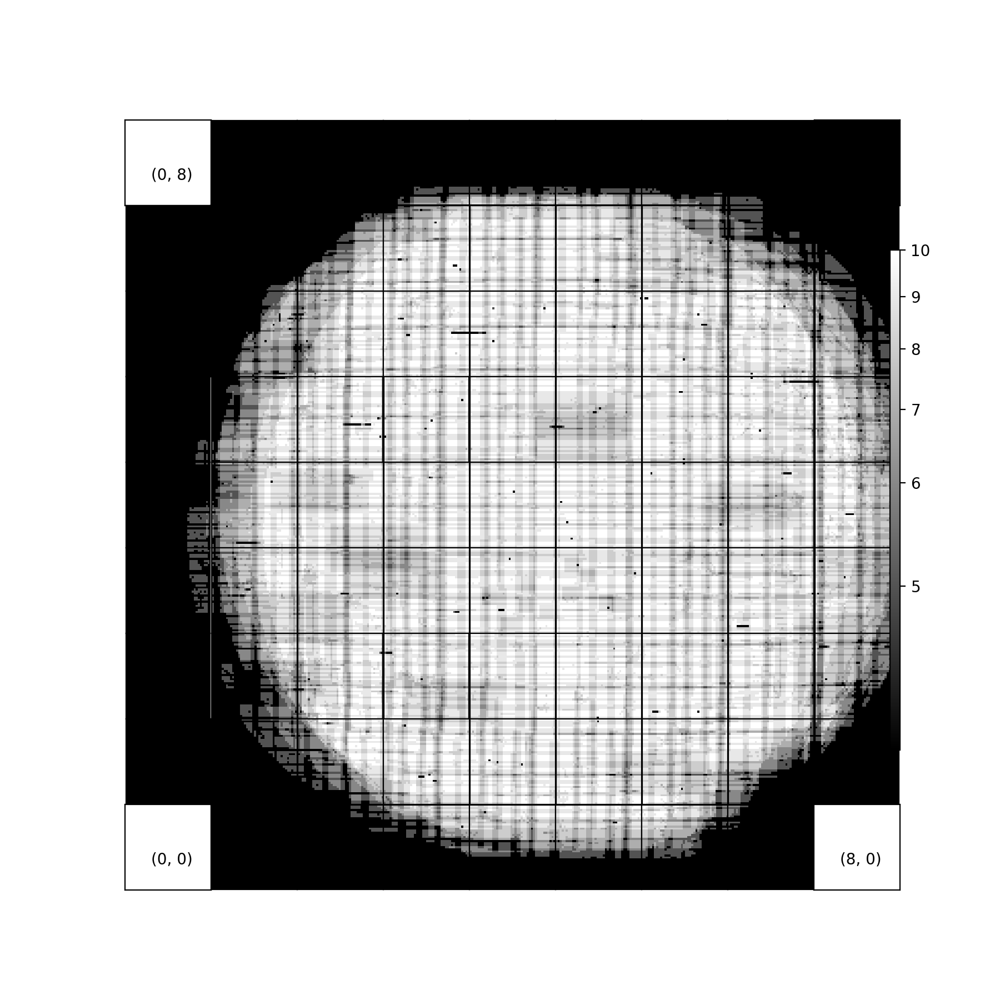

<IPython.core.display.Javascript object>


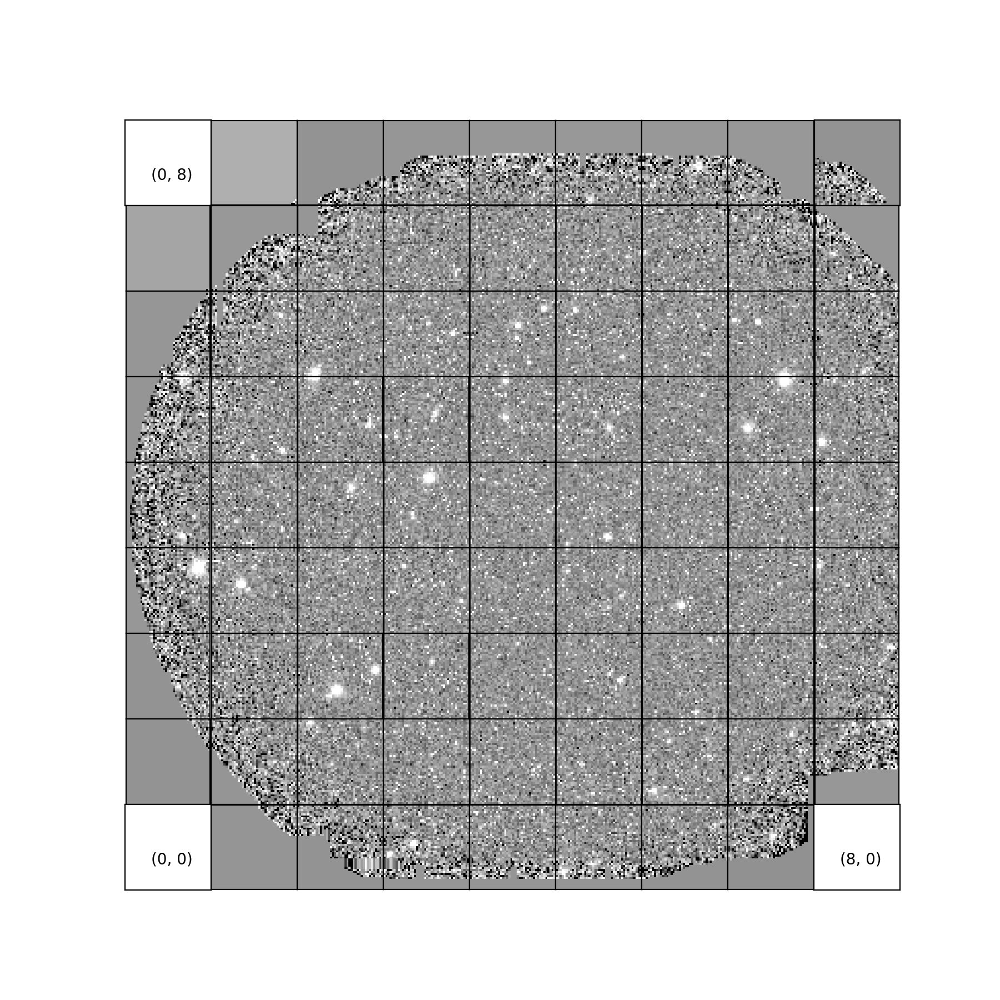

<IPython.core.display.Javascript object>


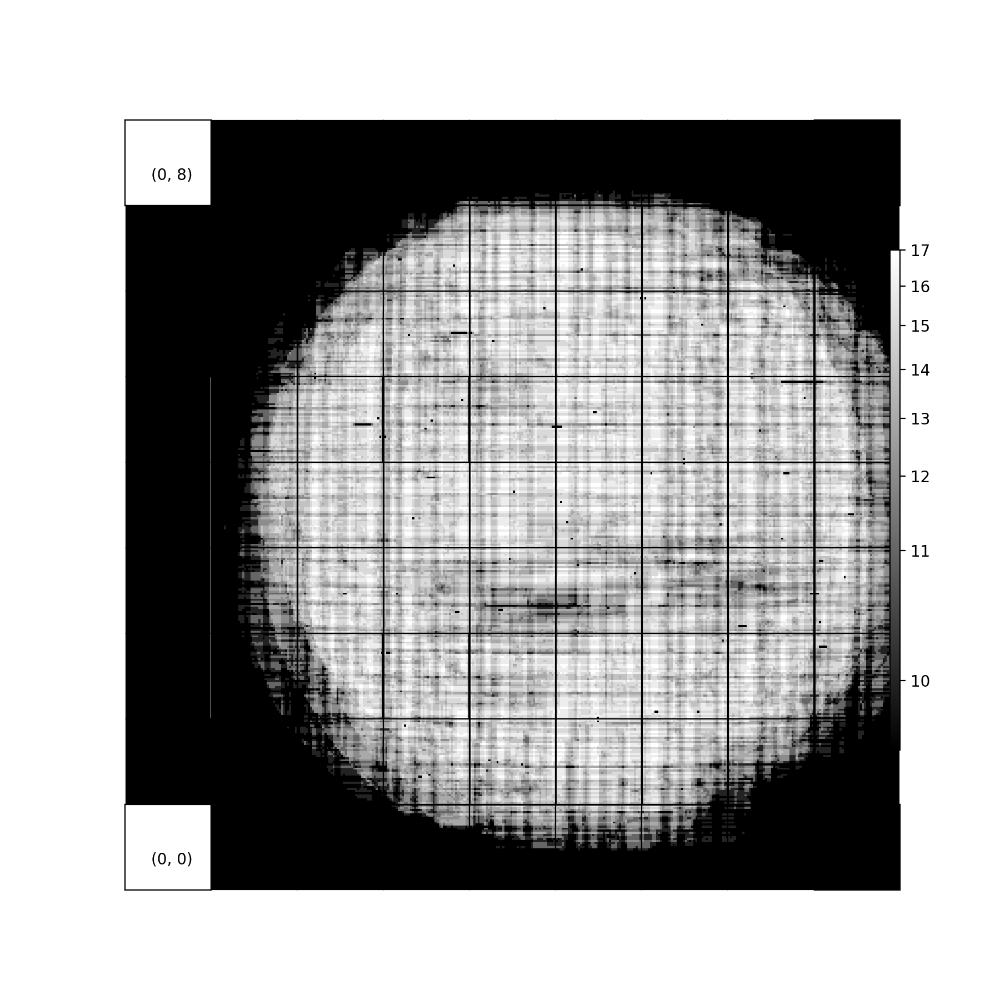

<IPython.core.display.Javascript object>


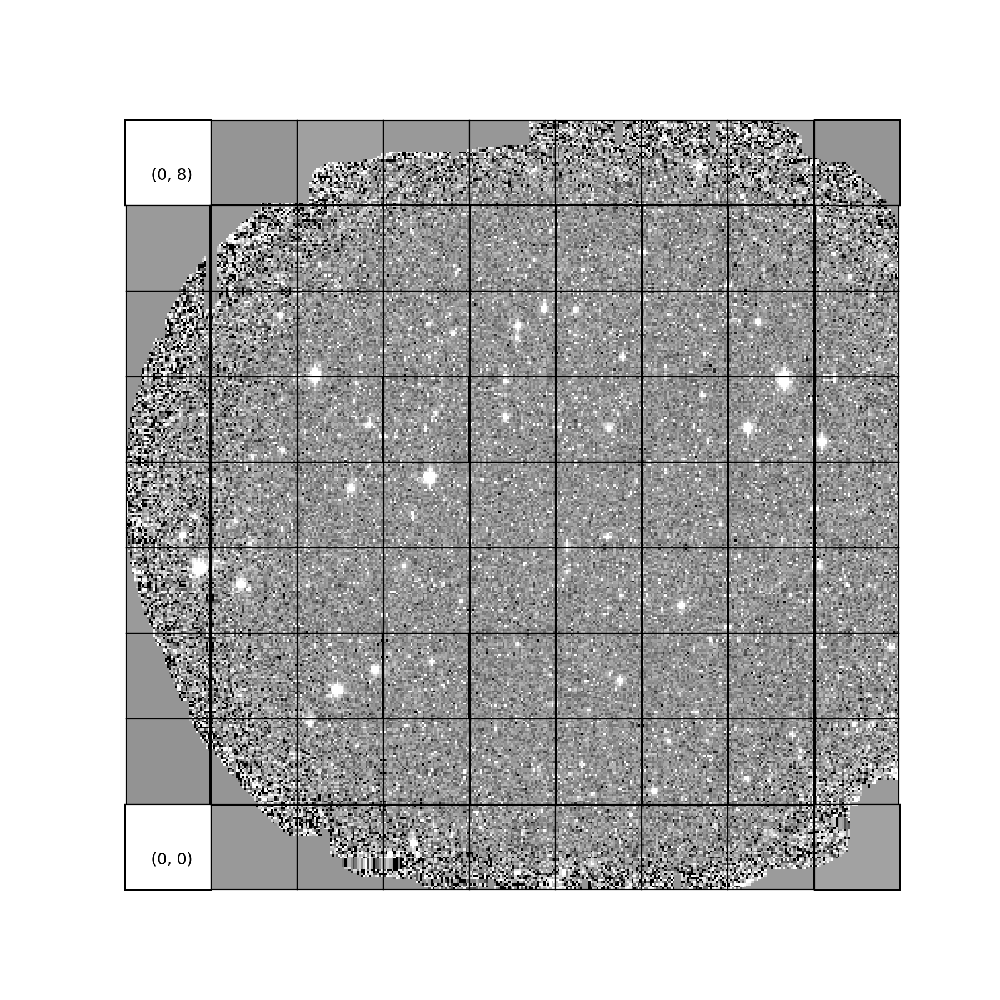

In [39]:
for band in ['g', 'r', 'i', 'z', 'y']:
    dataPatchList, _, _ = coa.getPatchConstituents(repo, tractIndex=9813, band=band, gen='gen3',
                                                   instrument='HSC', collections=collections,
                                                   skymapName='hsc_rings_v1')

    coa.mosaicCoadd(repo, dataPatchList, band=band, tractIndex=9813, refPatchIndex=(4,4), nImage=True,
                    gen='gen3', instrument='HSC', collections=collections, skymapName='hsc_rings_v1',
                    filename=band+'_nImage_mosaic.png')
    
    coa.mosaicCoadd(repo, dataPatchList, band=band, tractIndex=9813, refPatchIndex=(4,4), nImage=False,
                    gen='gen3', instrument='HSC', collections=collections, skymapName='hsc_rings_v1',
                    filename=band+'_mosaic.png', show_colorbar=False)

### Flux histograms galore!

<IPython.core.display.Javascript object>


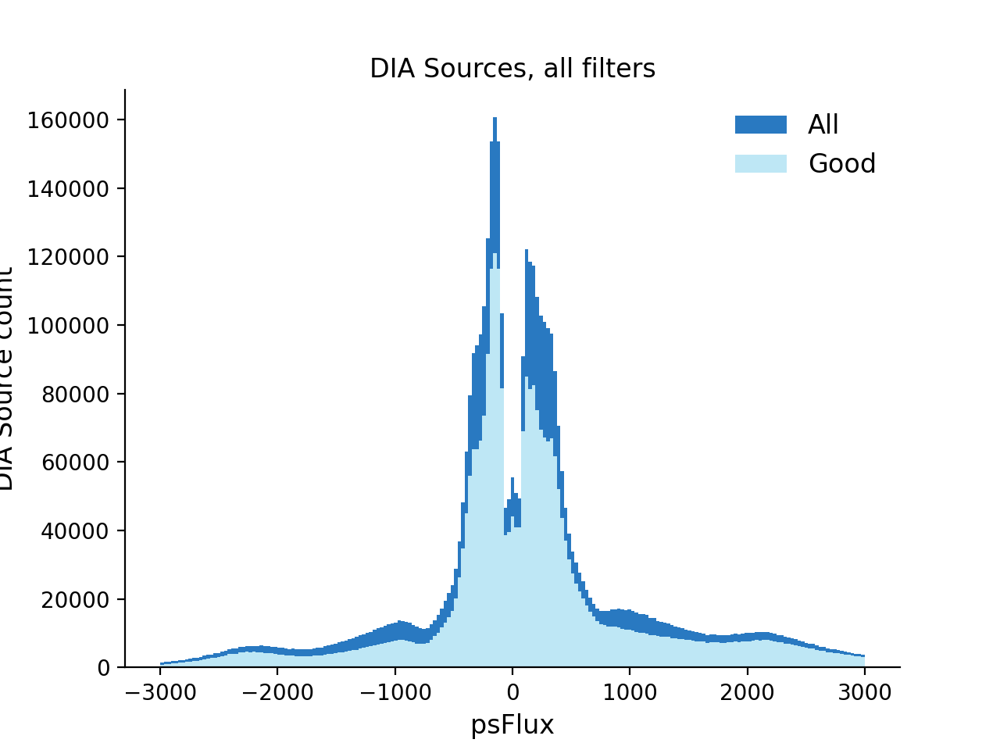

In [40]:
pla.plotFluxHistSrc(srcTable, goodSrc, fluxType='psFlux', label1='All', label2='Good',
                    title='DIA Sources, all filters')

<IPython.core.display.Javascript object>


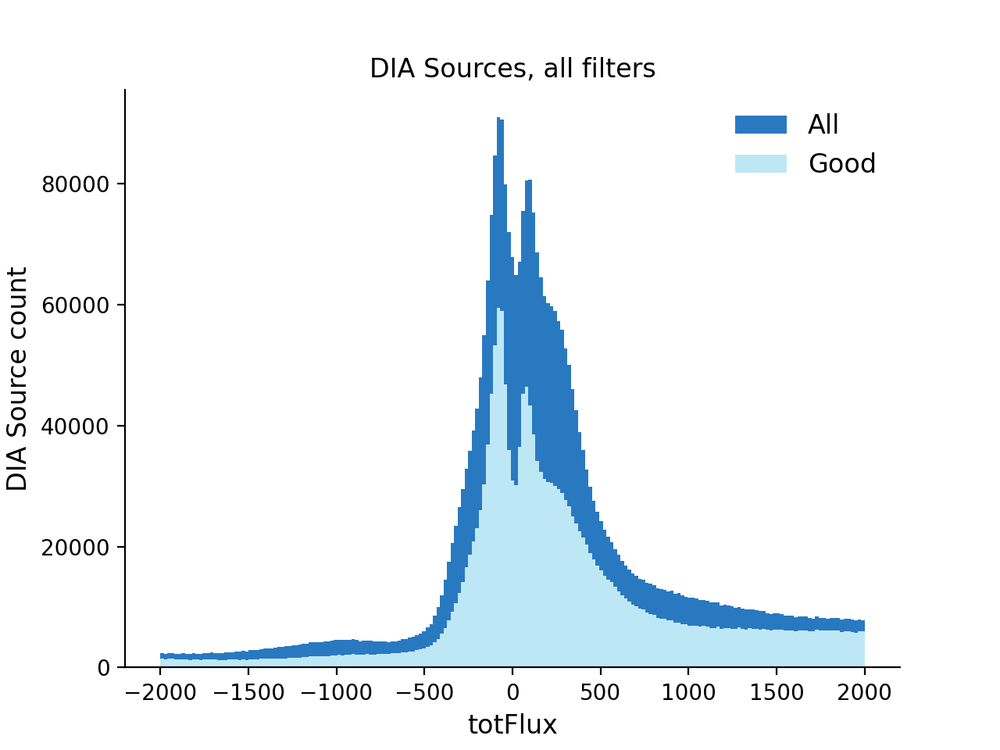

In [41]:
pla.plotFluxHistSrc(srcTable, goodSrc, fluxType='totFlux', label1='All', label2='Good',
                title='DIA Sources, all filters', binmin=-2e3, binmax=2e3)

<IPython.core.display.Javascript object>


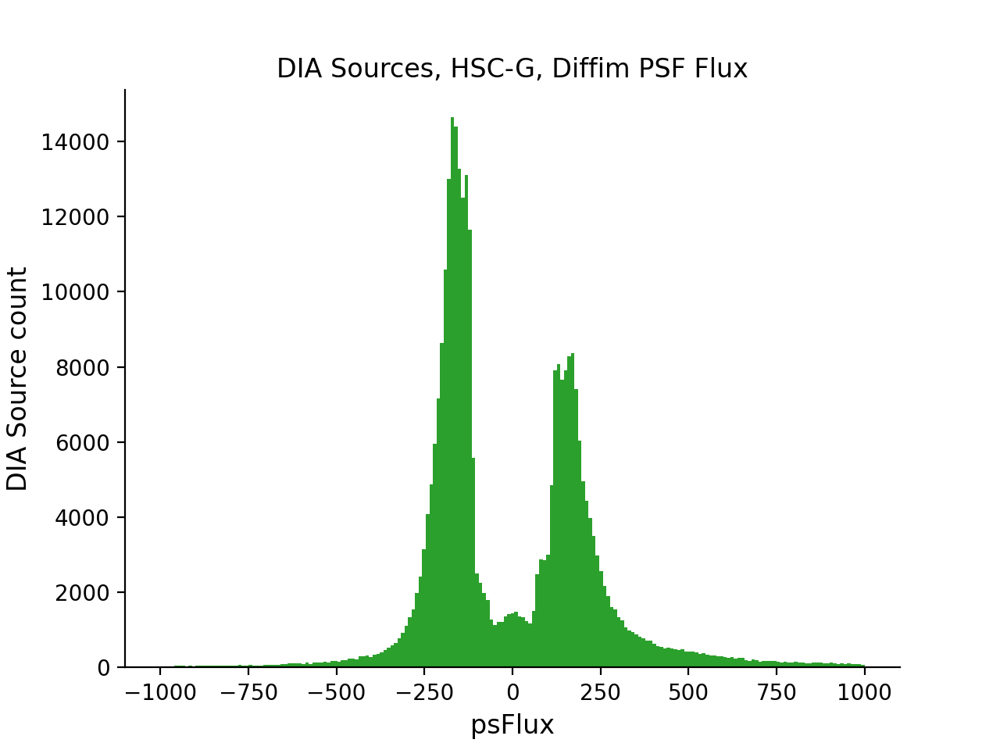

In [42]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'g'], fluxType='psFlux',
                    title='DIA Sources, HSC-G, Diffim PSF Flux', color1='C2', binmin=-1e3, binmax=1e3)

<IPython.core.display.Javascript object>


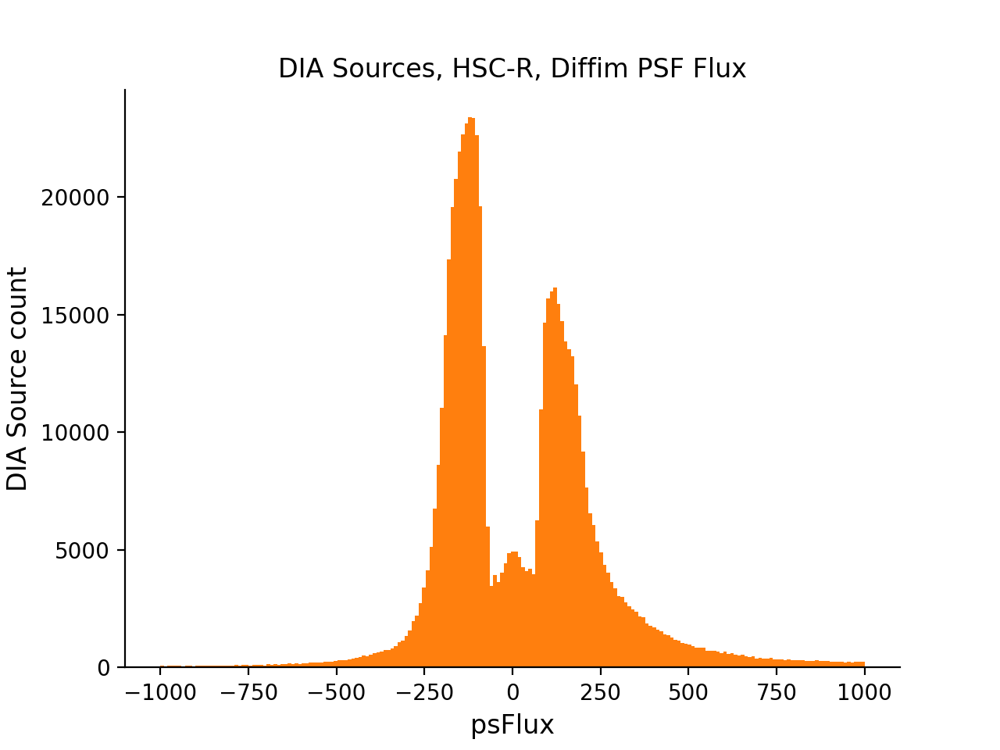

In [43]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'r'], fluxType='psFlux',
                    title='DIA Sources, HSC-R, Diffim PSF Flux', color1='C1', binmin=-1e3, binmax=1e3)

<IPython.core.display.Javascript object>


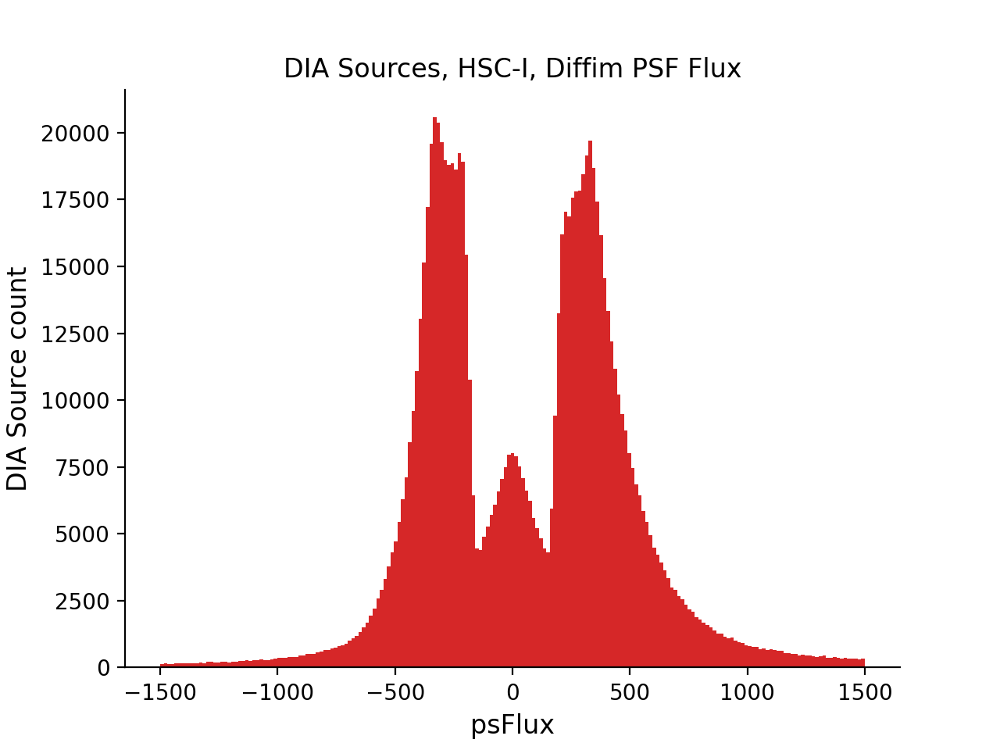

In [44]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'i'], fluxType='psFlux',
                    title='DIA Sources, HSC-I, Diffim PSF Flux', color1='C3', binmin=-1.5e3, binmax=1.5e3)

<IPython.core.display.Javascript object>


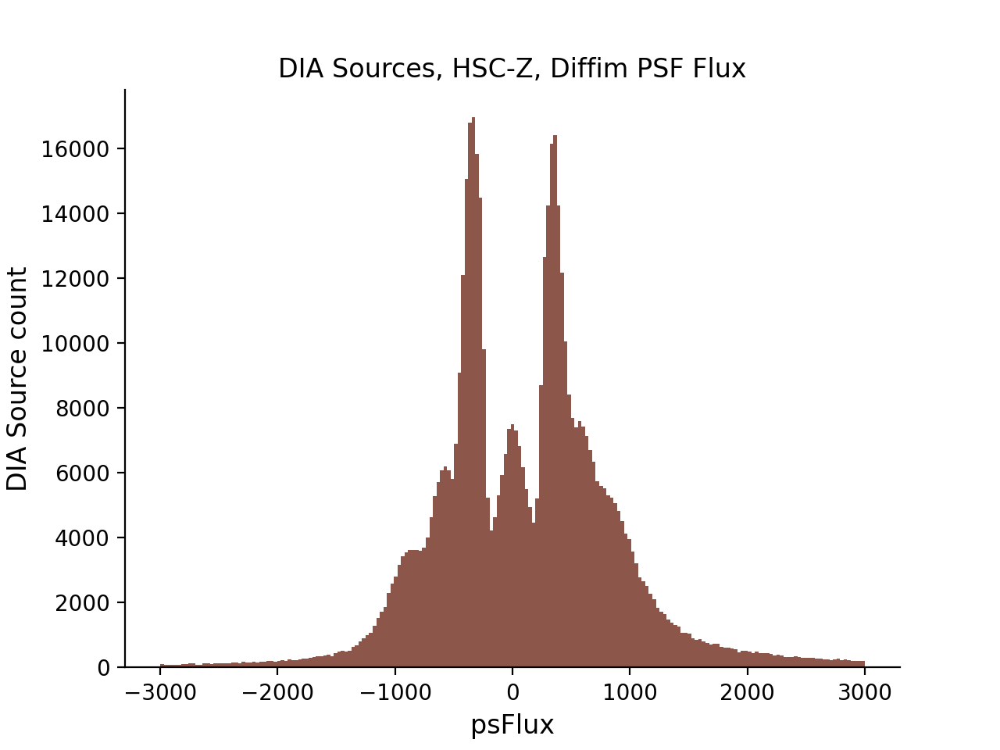

In [45]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'z'], fluxType='psFlux',
                    title='DIA Sources, HSC-Z, Diffim PSF Flux', color1='C5')

<IPython.core.display.Javascript object>


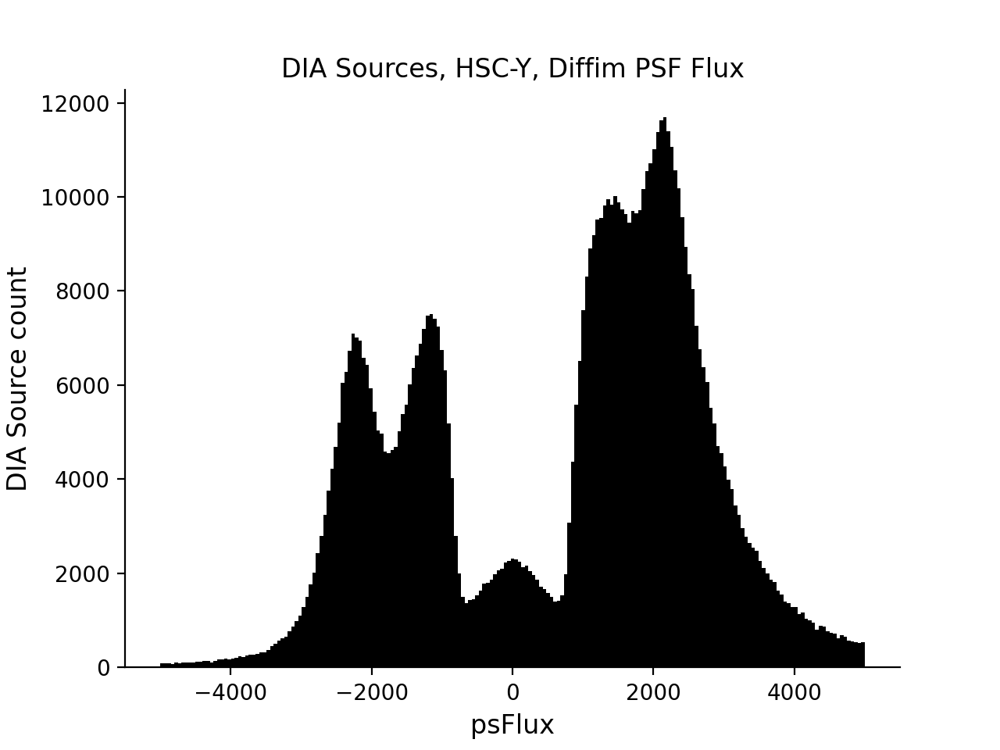

In [46]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'y'], fluxType='psFlux',
                    title='DIA Sources, HSC-Y, Diffim PSF Flux', color1='k', binmin=-5e3, binmax=5e3)

<IPython.core.display.Javascript object>


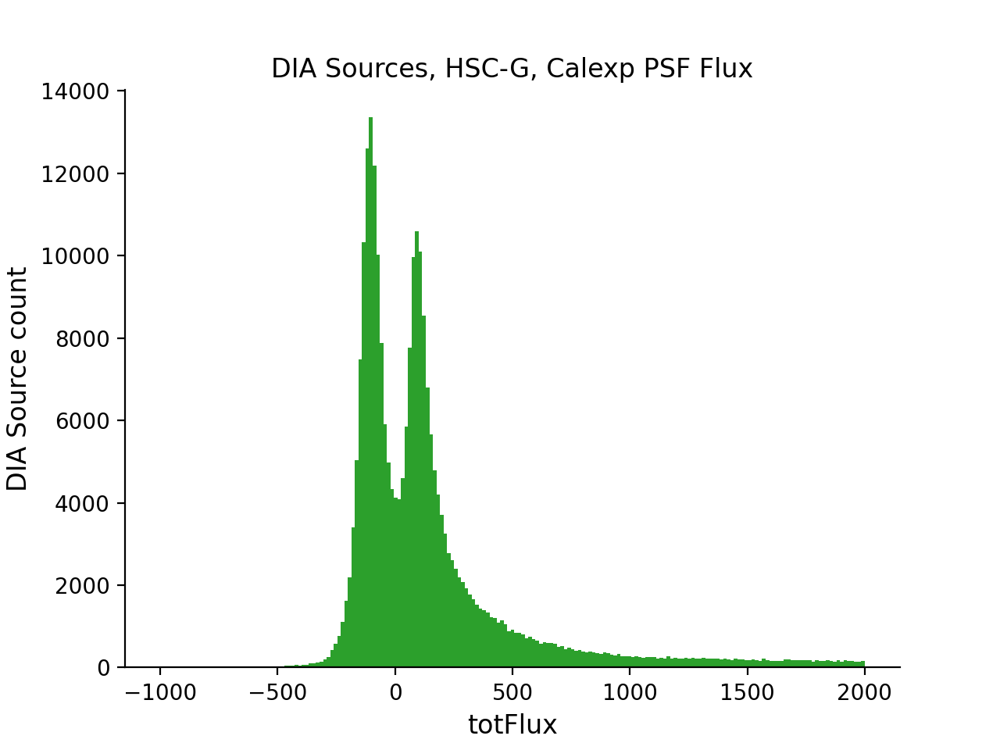

In [47]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'g'], fluxType='totFlux',
                    title='DIA Sources, HSC-G, Calexp PSF Flux', color1='C2', binmin=-1e3, binmax=2e3)

<IPython.core.display.Javascript object>


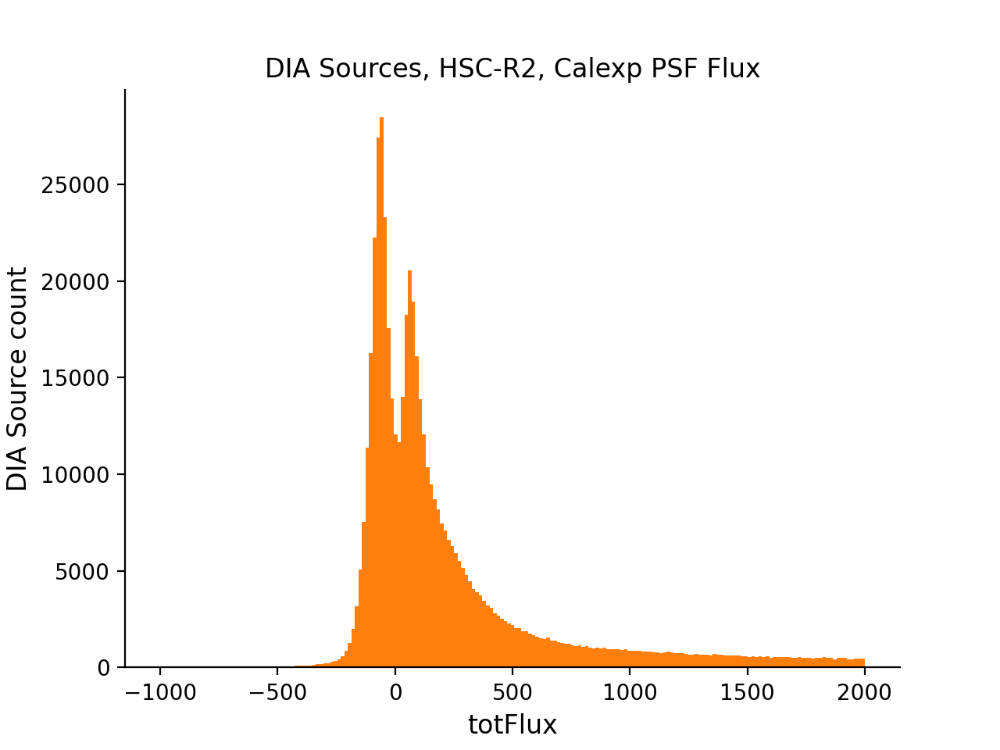

In [48]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'r'], fluxType='totFlux',
                    title='DIA Sources, HSC-R2, Calexp PSF Flux', color1='C1', binmin=-1e3, binmax=2e3)

<IPython.core.display.Javascript object>


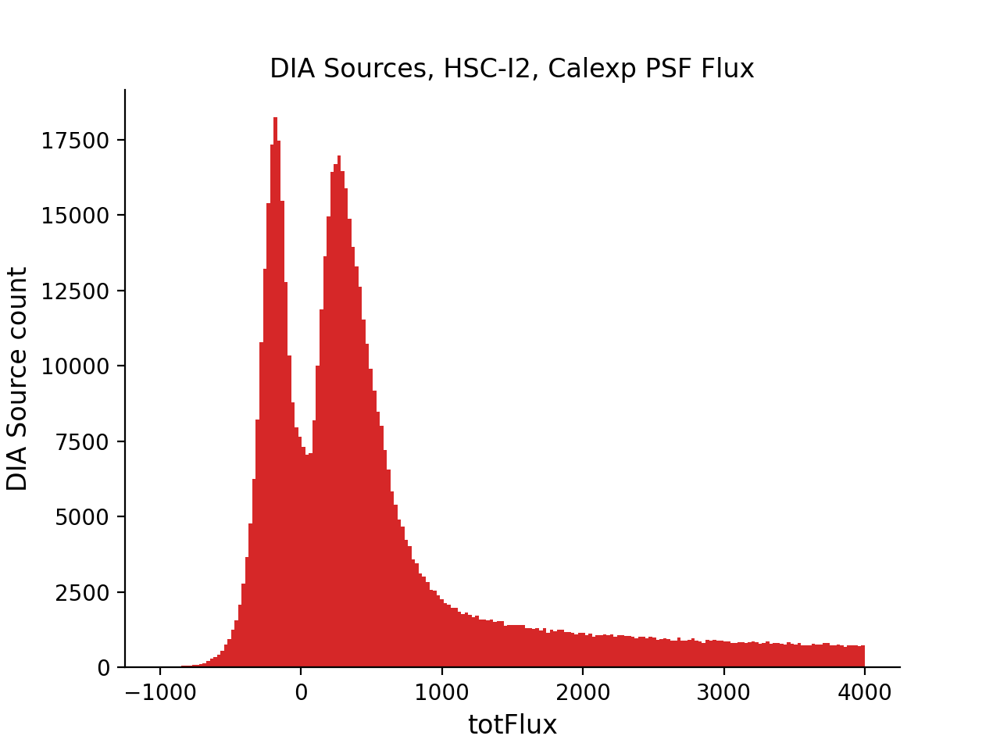

In [49]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'i'], fluxType='totFlux',
                    title='DIA Sources, HSC-I2, Calexp PSF Flux', color1='C3', binmin=-1e3, binmax=4e3)

<IPython.core.display.Javascript object>


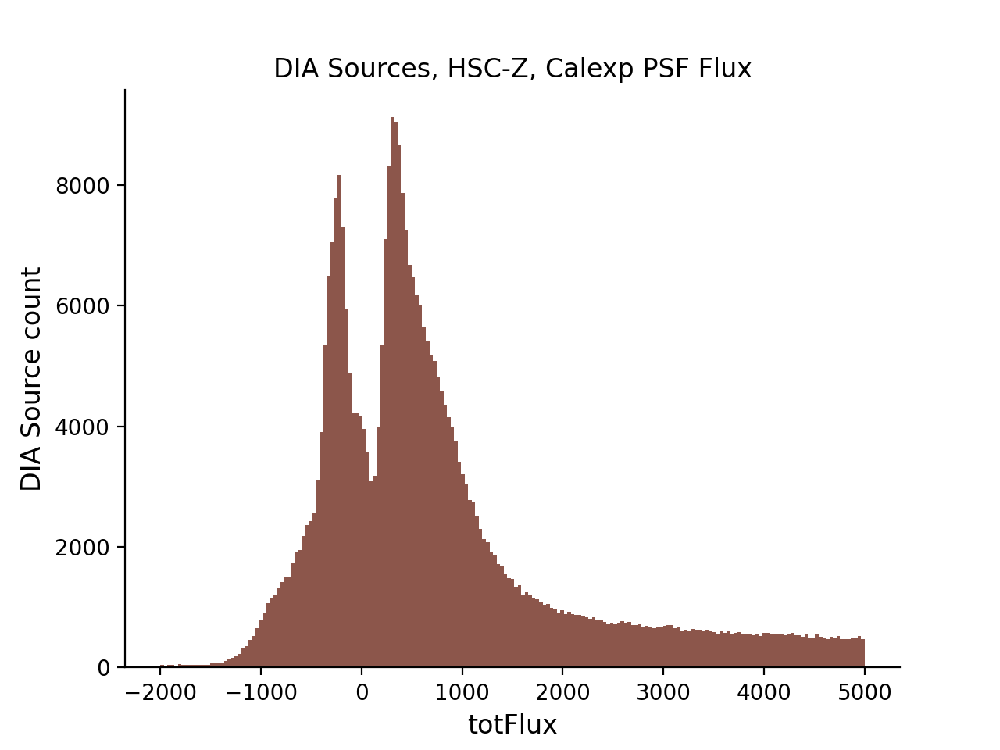

In [50]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'z'], fluxType='totFlux',
                    title='DIA Sources, HSC-Z, Calexp PSF Flux', color1='C5', binmin=-2e3, binmax=5e3)

<IPython.core.display.Javascript object>


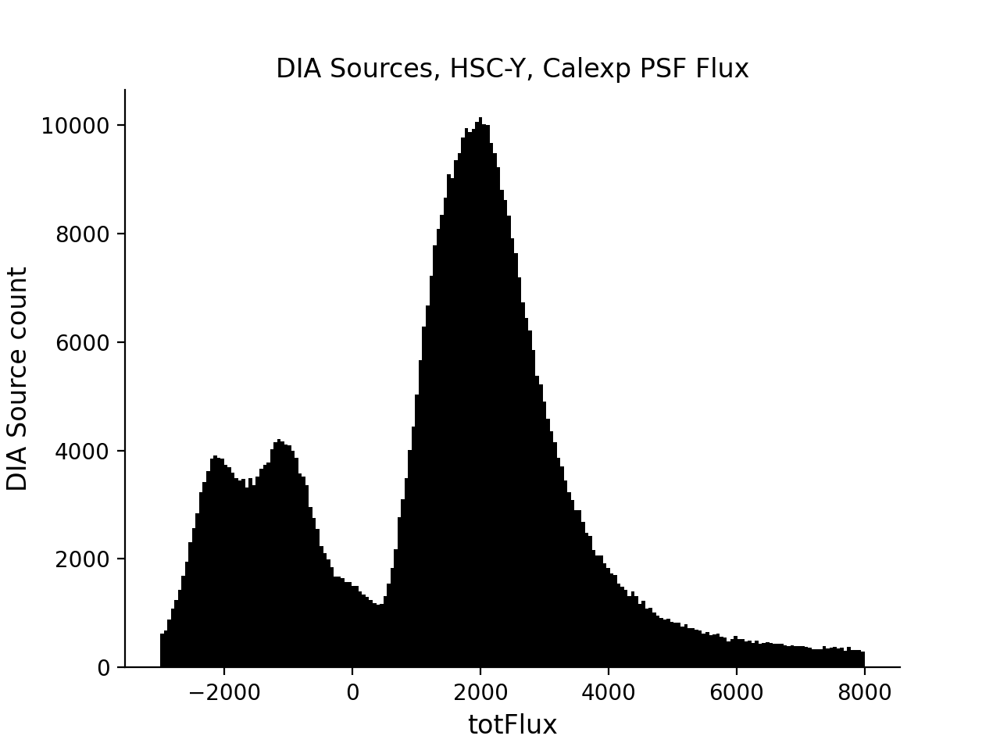

In [51]:
pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'y'], fluxType='totFlux',
                    title='DIA Sources, HSC-Y, Calexp PSF Flux', color1='k', binmin=-3e3, binmax=8e3)

<IPython.core.display.Javascript object>


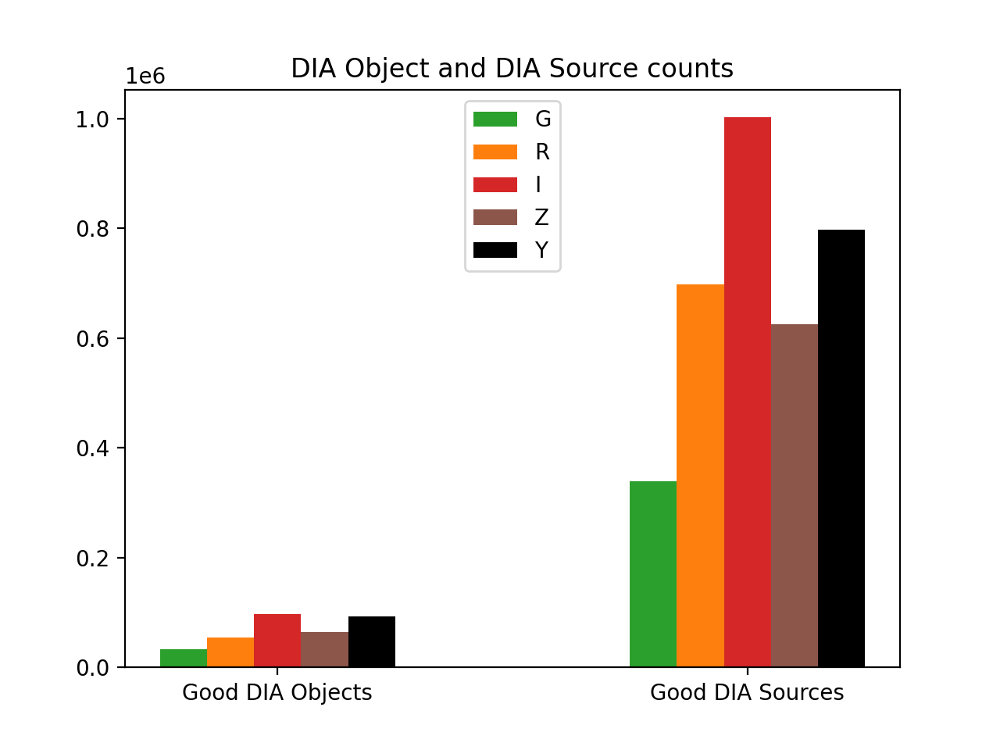

Text(0.5, 1.0, 'DIA Object and DIA Source counts')

In [52]:
fig, ax = plt.subplots()
barLabels = ['Good DIA Objects', 'Good DIA Sources']
xbar = np.array([0, 1])
width = 0.2

#hitsObjCompare = (goodObjHits['decl'] > 0)
#hitsSrcCompare = (goodSrcHits['decl'] > 0)

goodObjG = goodObj.loc[goodObj['gPSFluxMean'] > 0]
goodObjR = goodObj.loc[goodObj['rPSFluxMean'] > 0]
goodObjI = goodObj.loc[goodObj['iPSFluxMean'] > 0]
goodObjZ = goodObj.loc[goodObj['zPSFluxMean'] > 0]
goodObjY = goodObj.loc[goodObj['yPSFluxMean'] > 0]

goodSrcG = goodSrc.loc[goodSrc['filterName'] == 'g']
goodSrcR = goodSrc.loc[goodSrc['filterName'] == 'r']
goodSrcI = goodSrc.loc[goodSrc['filterName'] == 'i']
goodSrcZ = goodSrc.loc[goodSrc['filterName'] == 'z']
goodSrcY = goodSrc.loc[goodSrc['filterName'] == 'y']

ax.bar(xbar - width, [len(goodObjG), len(goodSrcG)], width/2, label='G', color='C2')
ax.bar(xbar - width/2, [len(goodObjR), len(goodSrcR)], width/2, label='R', color='C1')
ax.bar(xbar, [len(goodObjI), len(goodSrcI)], width/2, label='I', color='C3')
ax.bar(xbar + width/2, [len(goodObjZ), len(goodSrcZ)], width/2, label='Z', color='C5')
ax.bar(xbar + width, [len(goodObjY), len(goodSrcY)], width/2, label='Y', color='k')
#ax.bar(xbar + width + width/2, [len(goodObjHits[hitsObjCompare]), len(goodSrcHits[hitsSrcCompare])],
#       width/2, label='HiTS', color='C0')

plt.legend(loc='upper center')
ax.set_xticks([0, 1])
labels = ax.set_xticklabels(barLabels)
plt.title('DIA Object and DIA Source counts')

<IPython.core.display.Javascript object>


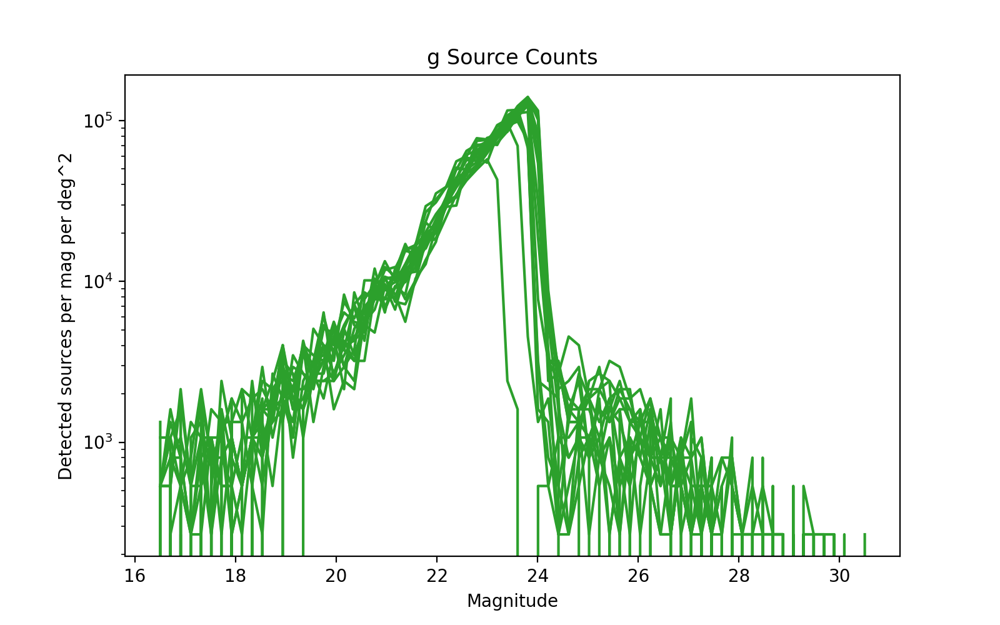

In [53]:
pla.source_magnitude_histogram(repo, goodSrc, 'g', 'HSC', collections)

<IPython.core.display.Javascript object>


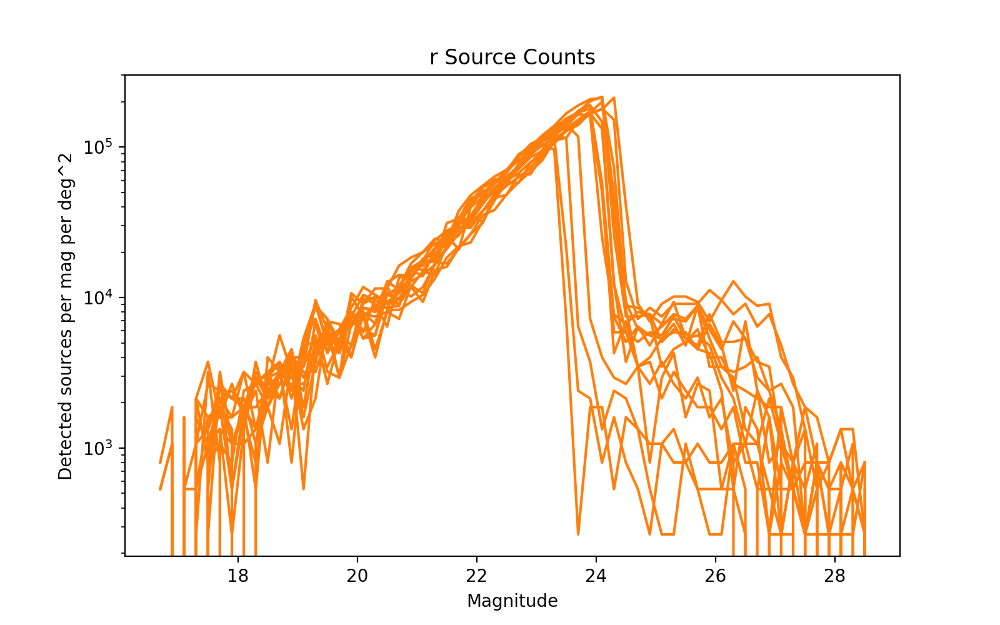

In [54]:
pla.source_magnitude_histogram(repo, srcTable, 'r', 'HSC', collections)

<IPython.core.display.Javascript object>


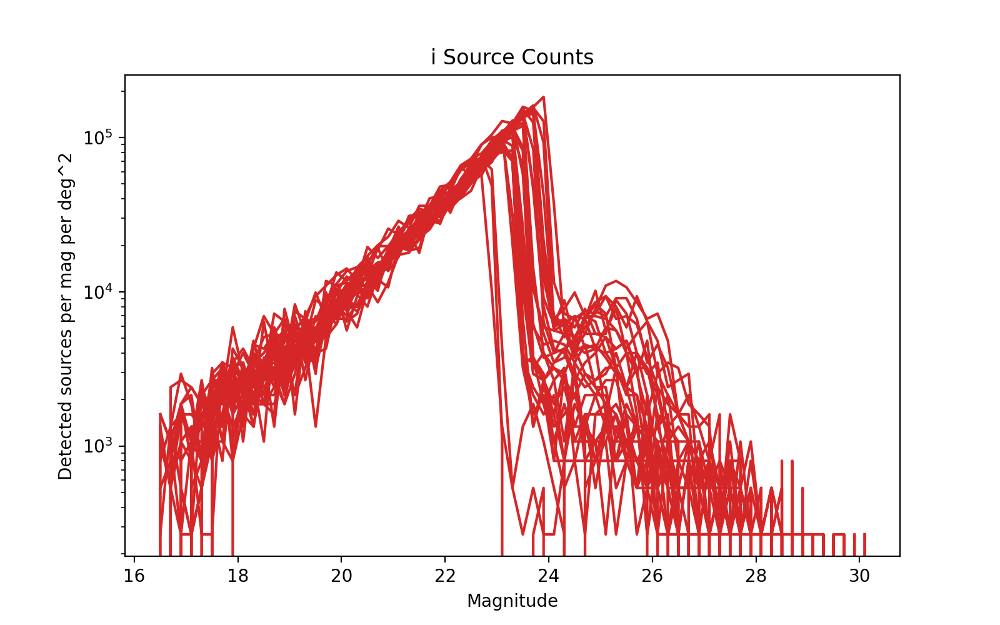

In [55]:
pla.source_magnitude_histogram(repo, goodSrc, 'i', 'HSC', collections)

<IPython.core.display.Javascript object>


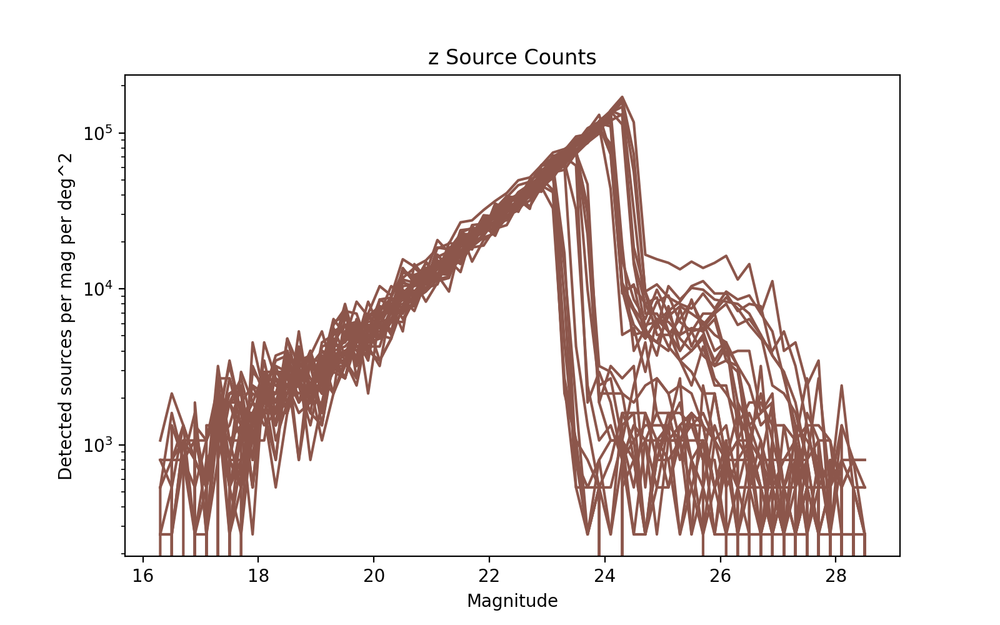

In [56]:
pla.source_magnitude_histogram(repo, goodSrc, 'z', 'HSC', collections)

<IPython.core.display.Javascript object>


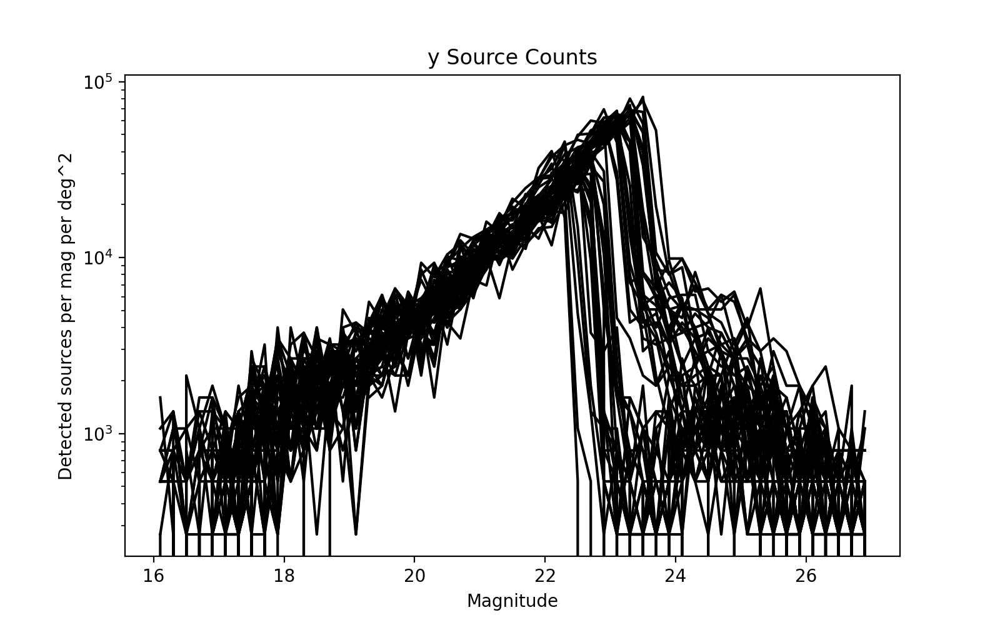

In [57]:
pla.source_magnitude_histogram(repo, goodSrc, 'y', 'HSC', collections)